## <u> Time Series Forercasting

## Name - Aman Goutam

## Energy Consumption in MEGA WATT of PJM Data

### PJM Dataset
PJM Hourly Energy Consumption Data -

PJM Interconnection LLC (PJM) is a regional transmission organization (RTO) in the United States. It is part of the Eastern Interconnection grid operating an electric transmission system serving all or parts of Delaware, Illinois, Indiana, Kentucky, Maryland, Michigan, New Jersey, North Carolina, Ohio, Pennsylvania, Tennessee, Virginia, West Virginia, and the District of Columbia.

The hourly power consumption data comes from PJM's website and are in megawatts (MW).regions have changed over the years so data may only appear for certain dates per region.

1.Split the last year into a test set- can you build a model to predict energy consumption?

2.Find trends in energy consumption around hours of the day, holidays, or long term trends?

3.Understand how daily trends change depending of the time of year. Summer trends are very different than winter trends.

4.Forecast for next 30 days.

## Importing Libraries

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np
%matplotlib inline

#!pip install plotly
import plotly.graph_objects as go                   
import plotly.express as px
from plotly.subplots import make_subplots

import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [2]:
import warnings
warnings.filterwarnings('ignore')

## Importing data

In [3]:
pjm_data = pd.read_csv('PJMW_hourly (1).csv',index_col = 'Datetime', parse_dates = ['Datetime'])

In [4]:
pjm_data

,PJMW_MW
Datetime,
2002-12-31 01:00:00,5077.0
2002-12-31 02:00:00,4939.0
2002-12-31 03:00:00,4885.0
2002-12-31 04:00:00,4857.0
2002-12-31 05:00:00,4930.0
...,...
2018-01-01 20:00:00,8401.0
2018-01-01 21:00:00,8373.0
2018-01-01 22:00:00,8238.0


## Data Understanding

In [5]:
pjm_data.head(10)

,PJMW_MW
Datetime,
2002-12-31 01:00:00,5077.0
2002-12-31 02:00:00,4939.0
2002-12-31 03:00:00,4885.0
2002-12-31 04:00:00,4857.0
2002-12-31 05:00:00,4930.0
2002-12-31 06:00:00,5126.0
2002-12-31 07:00:00,5493.0
2002-12-31 08:00:00,5824.0
2002-12-31 09:00:00,5962.0


In [6]:
#sorting the data
pjm_data.sort_index(inplace = True)

In [7]:
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [8]:
pjm_data.shape

(143206, 1)

In [9]:
pjm_data.isna().sum()

PJMW_MW    0
dtype: int64

In [10]:
pjm_data.dtypes

PJMW_MW    float64
dtype: object

In [11]:
pjm_data.describe()

,PJMW_MW
count,143206.000000
mean,5602.375089
std,979.142872
min,487.000000
25%,4907.000000
50%,5530.000000
75%,6252.000000
max,9594.000000


## Data pre-processing

<AxesSubplot:xlabel='Datetime'>

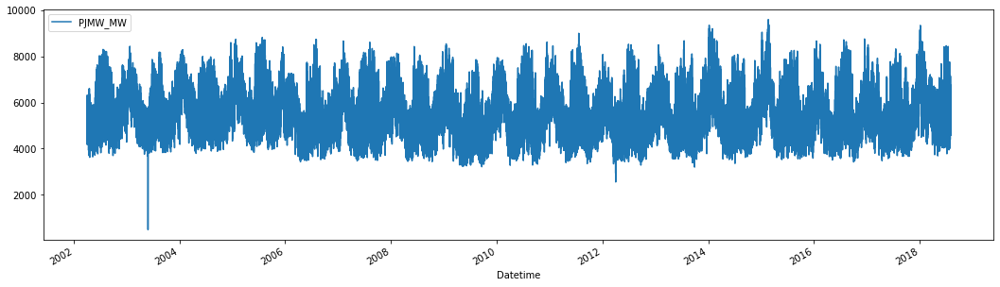

In [12]:
pjm_data.plot(figsize=(18,5),label=True)

array([[<AxesSubplot:title={'center':'PJMW_MW'}>]], dtype=object)

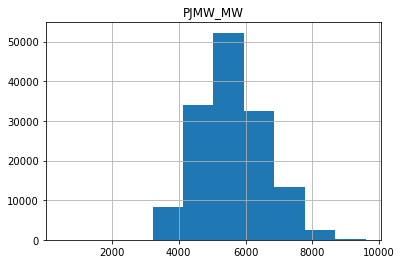

In [13]:
pjm_data.hist()

### Finding the duplicate values

In [14]:
duplicate_values = pjm_data[pjm_data.index.duplicated()]
print(pjm_data.loc[duplicate_values.index.values, :])

                     PJMW_MW
Datetime                    
2014-11-02 02:00:00   4571.0
2014-11-02 02:00:00   4613.0
2015-11-01 02:00:00   3927.0
2015-11-01 02:00:00   3832.0
2016-11-06 02:00:00   4114.0
2016-11-06 02:00:00   4089.0
2017-11-05 02:00:00   3984.0
2017-11-05 02:00:00   4042.0


In [15]:
pjm_data= pjm_data.groupby('Datetime').agg(np.mean)
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


##### 4 Rows reduced as duplicate data

### finding the missing values

In [16]:
pjm_data = pjm_data.asfreq('H')
print('Missing values: {}'.format(len(pjm_data[pjm_data['PJMW_MW'].isna()])))

Missing values: 30


### Interpolating the missing values

In [17]:
pjm_data['PJMW_MW'] = pjm_data['PJMW_MW'].interpolate(limit_area = 'inside', limit = None)

In [18]:
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


##### 30 rows increased by interpolating missing values

In [19]:
#copying the data
df = pjm_data.copy()

In [20]:
df

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


### converting the datetime to year,month,quarter,week,days,hours

In [21]:
df['Date']=df.index.date
df['year'] = df.index.year
df['month'] = df.index.month
df['month_name'] = df.index.month_name()
df['week_of_year'] = df.index.isocalendar().week
df['quarter'] = df.index.quarter
df['day_of_week_name'] = df.index.day_name()
df['day_of_month'] = df.index.day
df['day_of_year'] = df.index.dayofyear
df['hour'] = df.index.hour 

In [22]:
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5
...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22


In [23]:
df.head(20)

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5
2002-04-01 06:00:00,4723.0,2002-04-01,2002,4,April,14,2,Monday,1,91,6
2002-04-01 07:00:00,5180.0,2002-04-01,2002,4,April,14,2,Monday,1,91,7
2002-04-01 08:00:00,5482.0,2002-04-01,2002,4,April,14,2,Monday,1,91,8
2002-04-01 09:00:00,5616.0,2002-04-01,2002,4,April,14,2,Monday,1,91,9


### Maximum and minimum Energy Consumption

In [24]:
df[df["PJMW_MW"] == df["PJMW_MW"].max()]

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2015-02-20 08:00:00,9594.0,2015-02-20,2015,2,February,8,1,Friday,20,51,8


##### on 20th feb 2015 is the maximum consumption i.e 9594 mw

In [25]:
df[df["PJMW_MW"] == df["PJMW_MW"].min()]

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29,487.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,0


##### on 29th may the energy consumption is minimum i.e 487 mw

### maximum consumption in years

In [26]:
df.groupby(by='year')['PJMW_MW'].sum().sort_values(ascending=False)

year
2005    52894167.5
2004    51529495.5
2003    49934646.5
2014    49549721.0
2007    49363488.5
2015    49241343.0
2016    48996276.5
2010    48818465.0
2013    48676336.0
2008    48575109.5
2011    48262289.5
2017    48183510.5
2006    47524343.0
2012    47388259.5
2009    46342076.5
2002    37095135.5
2018    30041708.5
Name: PJMW_MW, dtype: float64

#### In Year 2005 maximum consumption

In [27]:
df.groupby(by='year')['PJMW_MW'].sum().sort_values(ascending=True)

year
2018    30041708.5
2002    37095135.5
2009    46342076.5
2012    47388259.5
2006    47524343.0
2017    48183510.5
2011    48262289.5
2008    48575109.5
2013    48676336.0
2010    48818465.0
2016    48996276.5
2015    49241343.0
2007    49363488.5
2014    49549721.0
2003    49934646.5
2004    51529495.5
2005    52894167.5
Name: PJMW_MW, dtype: float64

#### In Year 2018 minimum consumption

### Maximum and minimum consumption in months

In [28]:
df.groupby(by='month_name')['PJMW_MW'].sum().sort_values(ascending=False).head()

month_name
January     76753037.0
July        74136721.0
December    72191551.0
August      69592073.0
February    68307782.0
Name: PJMW_MW, dtype: float64

#### in january maximum consumption

In [29]:
df.groupby(by='month_name')['PJMW_MW'].sum().sort_values(ascending=True).head()

month_name
October      59488727.5
September    59971646.0
April        61465673.5
November     62246632.0
May          63440417.0
Name: PJMW_MW, dtype: float64

#### In october minimum consumption

## visualization

<AxesSubplot:xlabel='Datetime'>

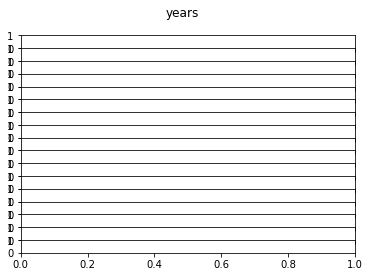

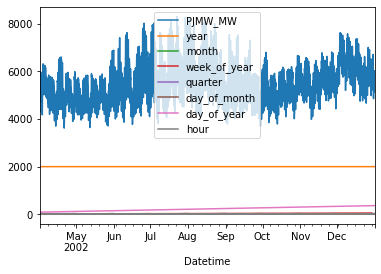

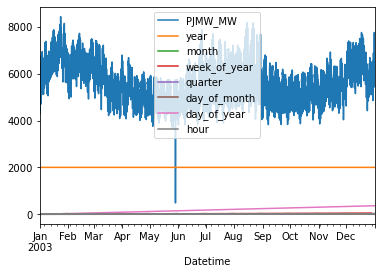

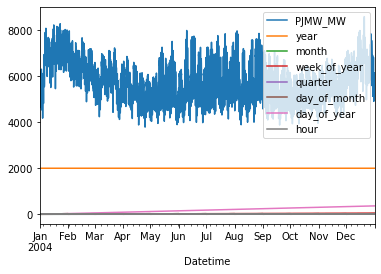

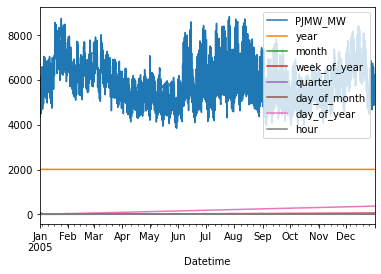

...

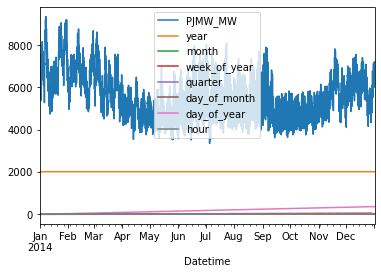

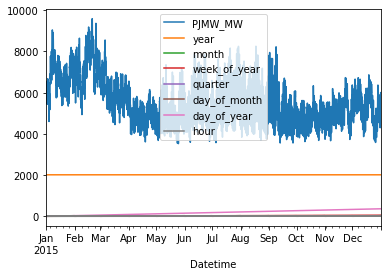

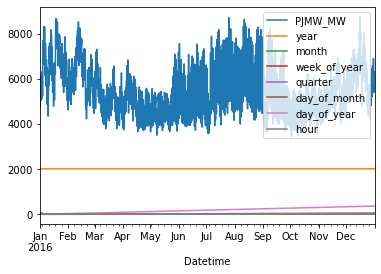

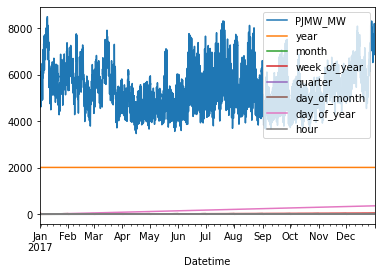

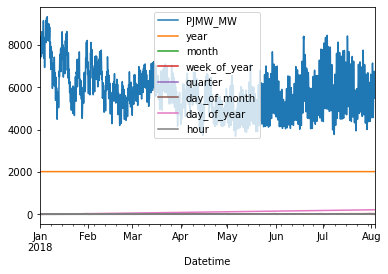

In [30]:
fig = plt.figure()
gs = fig.add_gridspec(17, hspace=0)
axs = gs.subplots(sharex=True, sharey=True)
fig.suptitle('years')
df.loc['2002'].plot()
df.loc['2003'].plot()
df.loc['2004'].plot()
df.loc['2005'].plot()
df.loc['2006'].plot()
df.loc['2007'].plot()
df.loc['2008'].plot()
df.loc['2009'].plot()
df.loc['2010'].plot()
df.loc['2011'].plot()
df.loc['2012'].plot()
df.loc['2013'].plot()
df.loc['2014'].plot()
df.loc['2015'].plot()
df.loc['2016'].plot()
df.loc['2017'].plot()
df.loc['2018'].plot()


##### we can see that in year 2003,there is an outlier on 29 th may

<AxesSubplot:xlabel='Datetime'>

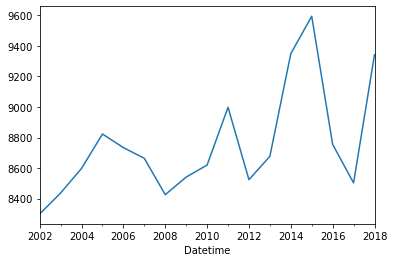

In [31]:
df.PJMW_MW.resample(rule='A').max().plot()

<AxesSubplot:xlabel='Datetime'>

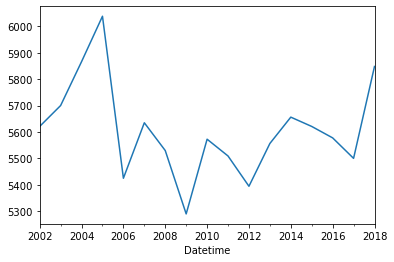

In [32]:
df.PJMW_MW.resample(rule='A').mean().plot()

<AxesSubplot:xlabel='Datetime'>

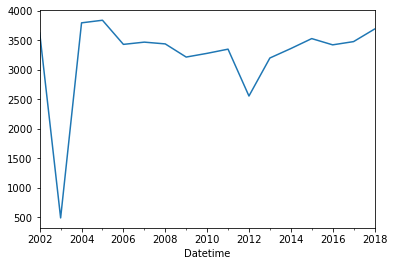

In [33]:
df.PJMW_MW.resample(rule='A').min().plot()

In [34]:
df['2003'].PJMW_MW.resample(rule='A').min()

Datetime
2003-12-31    487.0
Freq: A-DEC, Name: PJMW_MW, dtype: float64

In [35]:
df[df['PJMW_MW']==487.0]

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29,487.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,0


In [36]:
df['PJMW_MW'].mask(df['PJMW_MW']<500,inplace=True)

In [37]:
df['PJMW_MW']=df.PJMW_MW.interpolate(method='linear')

In [38]:
df['2003-05-29'].head()

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29 00:00:00,4938.5,2003-05-29,2003,5,May,22,2,Thursday,29,149,0
2003-05-29 01:00:00,4560.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,1
2003-05-29 02:00:00,4424.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,2
2003-05-29 03:00:00,4351.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,3
2003-05-29 04:00:00,4337.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,4


<AxesSubplot:xlabel='Datetime'>

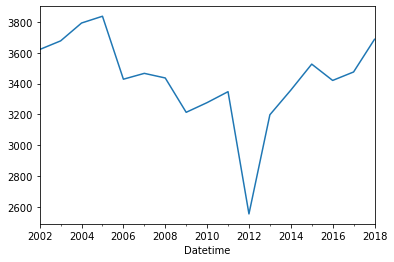

In [39]:
df.PJMW_MW.resample(rule='A').min().plot()

#### we see that there is no more outlier in 29th may 2003

### Now we are finding the holidays 

In [40]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calender
cal=calender()
holidays=pd.to_datetime(cal.holidays(df.index.min(),df.index.max()))
df['Date']=pd.to_datetime(df['Date'])
df['Holidays'] = df['Date'].apply(lambda x:1 if x in holidays else 0 )
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays
Datetime,,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1,0
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2,0
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3,0
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4,0
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20,0
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21,0
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22,0


In [41]:
y =[5,6]
df['Weekends']=df['day_of_week_name'].apply(lambda x:1 if x in y else 0)
df['Weekends'].value_counts()

0    143232
Name: Weekends, dtype: int64

In [42]:
df['day_of_week_name'].value_counts()

Tuesday      20472
Wednesday    20472
Thursday     20472
Monday       20471
Friday       20449
Saturday     20448
Sunday       20448
Name: day_of_week_name, dtype: int64

In [43]:
df['Holidays'].value_counts()

0    139344
1      3888
Name: Holidays, dtype: int64

### summarizing the value of months as seasons

In [44]:
df['Season']='NAN'
summer=[6,7,8,9]
Rainy=[10,11]
winter=[12,1,2]
spring=[3,4,5]
for i in range(0,143232):
    if df['month_name'][i] in summer:
        df['Season'][i]=1
    elif df['month_name'][i] in winter:
        df['Season'][i]=2
    elif df['month_name'][i] in Rainy:
        df['Season'][i]=3
    else: 
        df['Season'][i]=4

In [45]:
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays,Weekends,Season
Datetime,,,,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1,0,0,4
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2,0,0,4
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3,0,0,4
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4,0,0,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20,0,0,4
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21,0,0,4
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22,0,0,4


In [46]:
df['Season'].value_counts()

4    143232
Name: Season, dtype: int64

In [47]:
df['month_name'].value_counts()

May          12648
July         12648
June         12240
April        12239
August       11953
October      11904
December     11904
January      11904
March        11904
September    11520
November     11520
February     10848
Name: month_name, dtype: int64

In [48]:
df.tail(20)

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays,Weekends,Season
Datetime,,,,,,,,,,,,,,
2018-08-02 05:00:00,4594.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,5,0,0,4
2018-08-02 06:00:00,4826.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,6,0,0,4
2018-08-02 07:00:00,5114.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,7,0,0,4
2018-08-02 08:00:00,5333.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,8,0,0,4
2018-08-02 09:00:00,5597.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,9,0,0,4
2018-08-02 10:00:00,5775.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,10,0,0,4
2018-08-02 11:00:00,6050.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,11,0,0,4
2018-08-02 12:00:00,6152.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,12,0,0,4
2018-08-02 13:00:00,6299.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,13,0,0,4


### visualisation

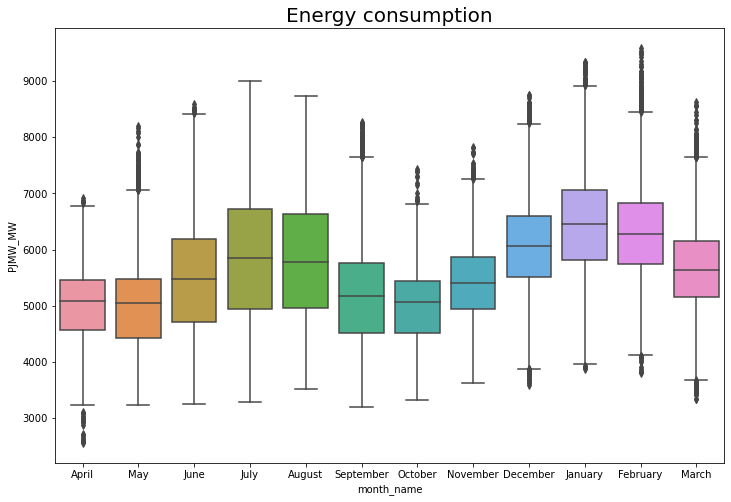

In [49]:
plt.figure(figsize=(12,8))
sns.boxplot(x = 'month_name', y = 'PJMW_MW',data = df)
plt.title('Energy consumption', size = 20)
plt.show()

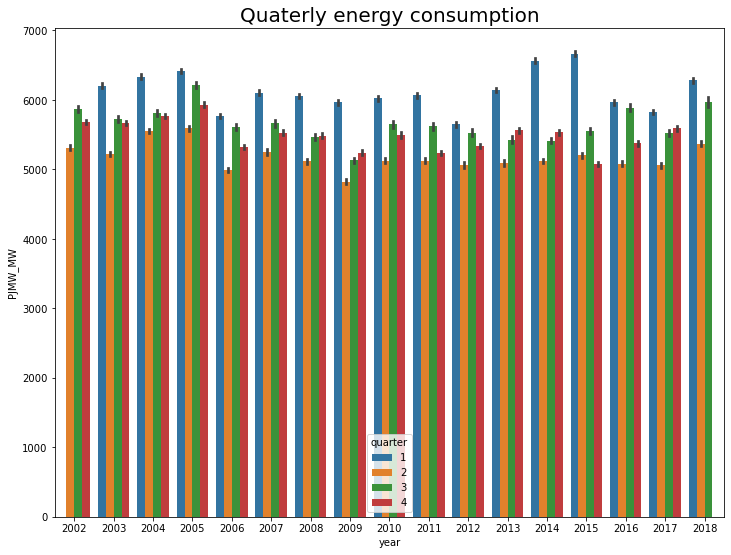

In [50]:
plt.figure(figsize=(12,9))
sns.barplot(x='year',y='PJMW_MW',hue = 'quarter',data =df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

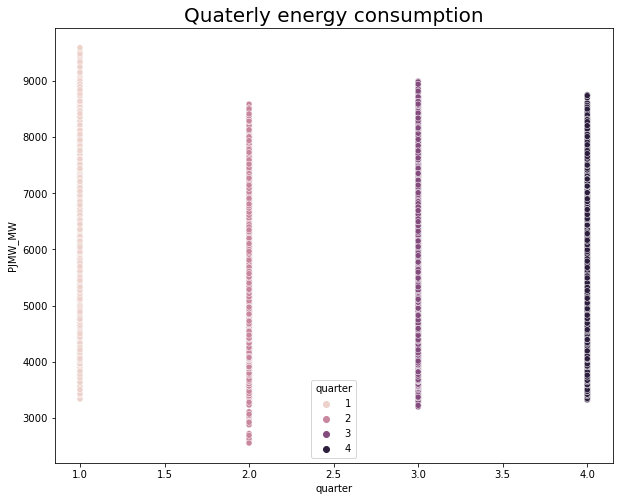

In [51]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='quarter',y='PJMW_MW',hue='quarter', data=df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

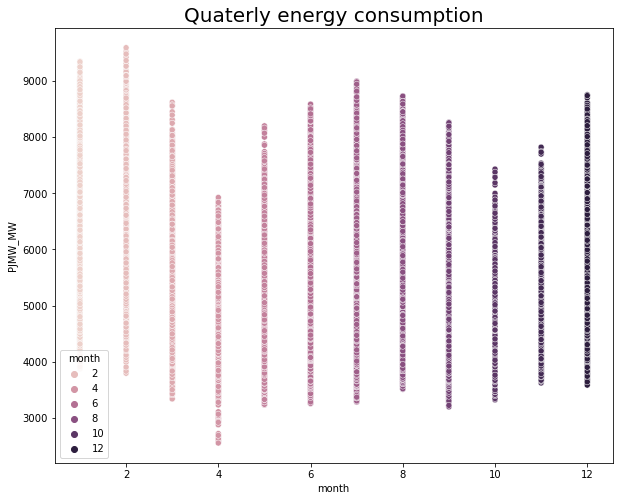

In [52]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='month',y='PJMW_MW',hue='month', data=df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

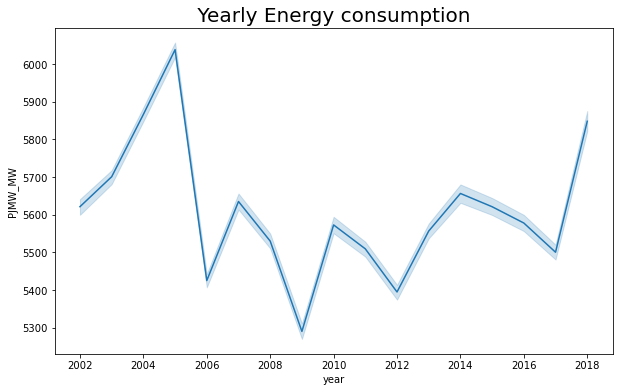

In [53]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=df['year'],y=df['PJMW_MW'],data=df)
plt.title(' Yearly Energy consumption ',size = 20)
plt.show()

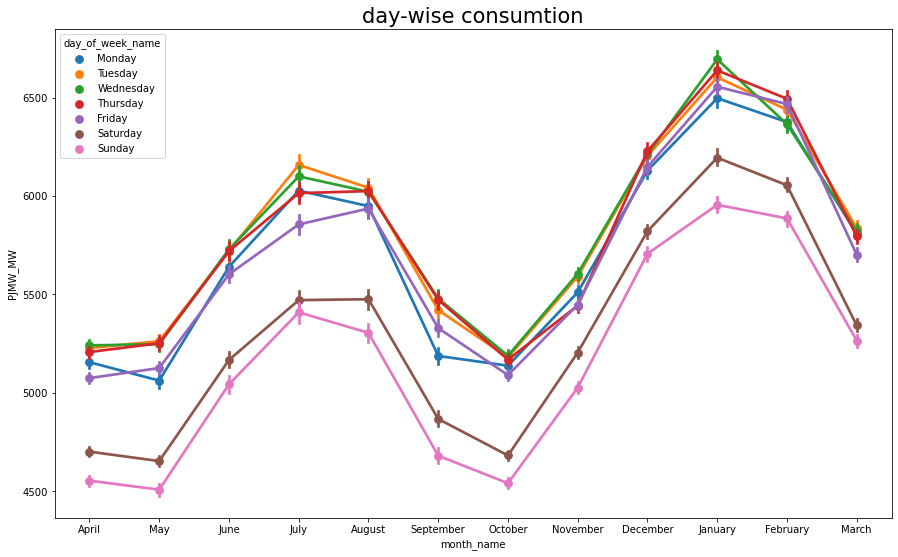

In [54]:
plt.figure(figsize=(15,9))
sns.pointplot(x='month_name', y='PJMW_MW', hue='day_of_week_name', data=df)
plt.title('day-wise consumtion',size = 21)
plt.show()

### Resampling Method

In [55]:
endmoth_min_energy=df['PJMW_MW'].resample(rule='A').min().head(30)
endmonth_max_energy=df['PJMW_MW'].resample(rule='A').max().head(20)
enegy_range =endmonth_max_energy-endmoth_min_energy
print(enegy_range)

Datetime
2002-12-31    4679.0
2003-12-31    4760.0
2004-12-31    4805.0
2005-12-31    4986.0
2006-12-31    5306.0
2007-12-31    5198.0
2008-12-31    4990.0
2009-12-31    5328.0
2010-12-31    5344.0
2011-12-31    5651.0
2012-12-31    5971.0
2013-12-31    5480.0
2014-12-31    5992.0
2015-12-31    6068.0
2016-12-31    5335.0
2017-12-31    5028.0
2018-12-31    5655.0
Freq: A-DEC, Name: PJMW_MW, dtype: float64


#### we saw that the ranges of mw b\w 4679 - 6068

<AxesSubplot:xlabel='Datetime'>

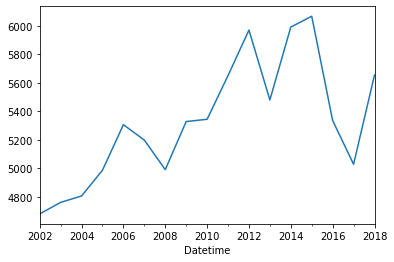

In [56]:
enegy_range.plot()

<AxesSubplot:xlabel='Datetime'>

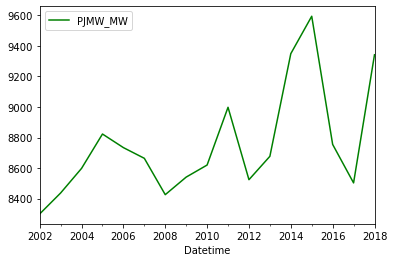

In [57]:
# plot for maximum mw in 2015
df.resample(rule='A').max()['PJMW_MW'].plot(legend= True,color='g')

<AxesSubplot:xlabel='Datetime'>

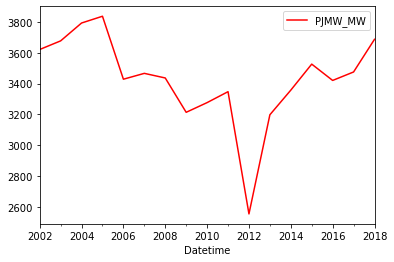

In [58]:
#plot for minimum mw in 2003
df.resample(rule='A').min()['PJMW_MW'].plot(legend= True,color='r')

### By Resampling we can find the maximum , minimum and mean values

In [59]:
df['PJMW_MW'].resample(rule='B').max().head()

Datetime
2002-04-01    5978.0
2002-04-02    5797.0
2002-04-03    6317.0
2002-04-04    6254.0
2002-04-05    6240.0
Freq: B, Name: PJMW_MW, dtype: float64

In [60]:
df['PJMW_MW'].resample(rule='B').min().head()

Datetime
2002-04-01    4306.0
2002-04-02    4713.0
2002-04-03    4178.0
2002-04-04    5021.0
2002-04-05    4689.0
Freq: B, Name: PJMW_MW, dtype: float64

In [61]:
df['PJMW_MW'].resample(rule='B').mean().head()

Datetime
2002-04-01    5271.173913
2002-04-02    5310.416667
2002-04-03    5325.916667
2002-04-04    5670.791667
2002-04-05    5368.798611
Freq: B, Name: PJMW_MW, dtype: float64

## ploting for each max,min,mean

<AxesSubplot:xlabel='Datetime'>

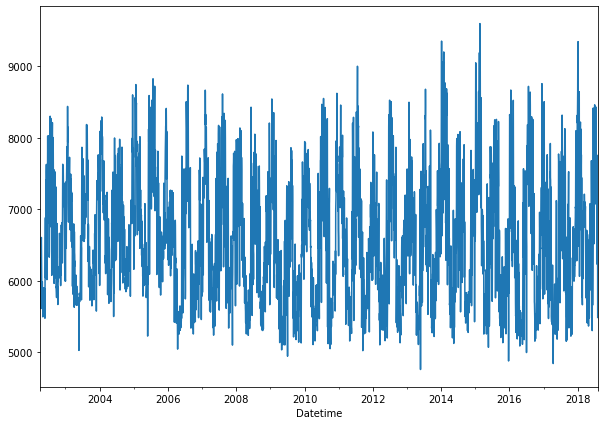

In [62]:
df['PJMW_MW'].resample(rule='B').max().plot(figsize = (10,7))

<AxesSubplot:xlabel='Datetime'>

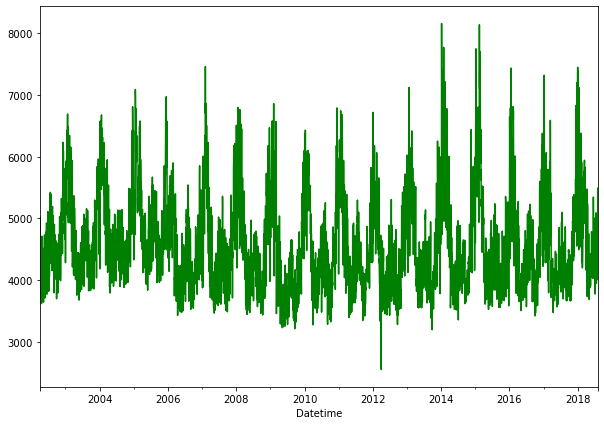

In [63]:
df['PJMW_MW'].resample(rule='B').min().plot(figsize = (10,7),color = 'g')

<AxesSubplot:xlabel='Datetime'>

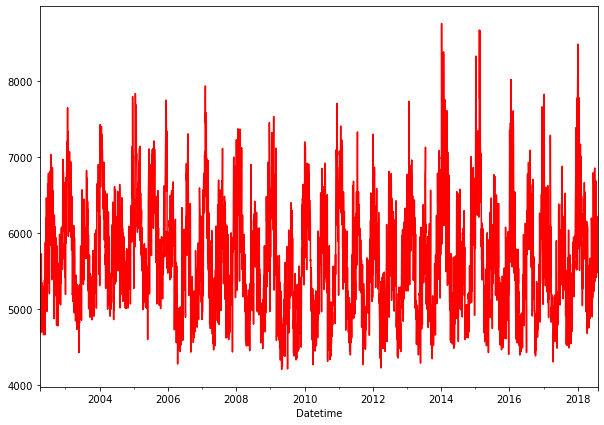

In [64]:
df['PJMW_MW'].resample(rule='B').mean().plot(figsize = (10,7),color = 'r')

In [65]:
# Creating times grouped dataframes in order to analyse them

df_year = df.groupby('year')['PJMW_MW'].sum()
df_month = df.groupby('month_name', sort = False)['PJMW_MW'].sum()
df_week_of_year = df.groupby('week_of_year')['PJMW_MW'].sum()
df_quarter = df.groupby('quarter')['PJMW_MW'].sum()
df_day_of_week = df.groupby('day_of_week_name', sort = False)['PJMW_MW'].sum()
df_day_of_month = df.groupby('day_of_month')['PJMW_MW'].sum()
df_day_of_year = df.groupby('day_of_year')['PJMW_MW'].sum()
df_hour = df.groupby('hour')['PJMW_MW'].sum()

In [66]:
fig = make_subplots(rows=4, cols=2, vertical_spacing = 0.200,
                    subplot_titles=(['Year', 'Month', 'Day of Week', 'Day of Month', 'Week of Year', 'Day of year', 'Hour', 'Quarter']))

fig.add_trace(go.Scatter(x=df_year.index, y = df_year), row=1, col=1)
fig.add_trace(go.Scatter(x=df_month.index, y=df_month), row=1, col=2)
fig.add_trace(go.Scatter(x=df_week_of_year.index, y=df_week_of_year), row=3, col=1)
fig.add_trace(go.Scatter(x=df_day_of_week.index, y=df_day_of_week), row=2, col=1)
fig.add_trace(go.Scatter(x=df_day_of_month.index, y=df_day_of_month), row=2, col=2)
fig.add_trace(go.Scatter(x=df_day_of_year.index, y=df_day_of_year), row=3, col=2)
fig.add_trace(go.Scatter(x=df_hour.index, y=df_hour), row=4, col=1)
fig.add_trace(go.Scatter(x=df_quarter.index, y=df_quarter), row=4, col=2)

fig.update_layout(title = 'Energy Consumption of PJME per', height = 700, showlegend = False)

fig.show()

In [67]:
# BY using slider function it is easy to visulalize
figure = px.line(df, x=df.index, y = df.PJMW_MW)

figure.update_layout(title = "Energy Consumption of PJME from year  2002 to 2018", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", 
                  xaxis_rangeslider_visible=True)
figure.show()

In [68]:
df.corr()

,PJMW_MW,year,month,week_of_year,quarter,day_of_month,day_of_year,hour,Holidays,Weekends
PJMW_MW,1.000000,-0.046837,-0.152383,-0.151562,-0.159915,-0.006072,-0.150875,4.473128e-01,-1.447481e-02,NaN
year,-0.046837,1.000000,-0.077682,-0.076304,-0.077328,-0.001896,-0.077423,-3.923280e-05,-1.040085e-03,NaN
month,-0.152383,-0.077682,1.000000,0.970054,0.970840,0.010207,0.996439,-1.356767e-05,2.549798e-02,NaN
week_of_year,-0.151562,-0.076304,0.970054,1.000000,0.945407,0.067433,0.971517,-1.319881e-05,3.512584e-02,NaN
quarter,-0.159915,-0.077328,0.970840,0.945407,1.000000,0.011954,0.967611,-1.047025e-05,3.483795e-02,NaN
day_of_month,-0.006072,-0.001896,0.010207,0.067433,0.011954,1.000000,0.094187,-2.635322e-06,-1.552202e-02,NaN
day_of_year,-0.150875,-0.077423,0.996439,0.971517,0.967611,0.094187,1.000000,-1.375583e-05,2.455236e-02,NaN
hour,0.447313,-0.000039,-0.000014,-0.000013,-0.000010,-0.000003,-0.000014,1.000000e+00,-3.705443e-18,NaN
Holidays,-0.014475,-0.001040,0.025498,0.035126,0.034838,-0.015522,0.024552,-3.705443e-18,1.000000e+00,NaN
Weekends,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Figure size 1440x864 with 0 Axes>

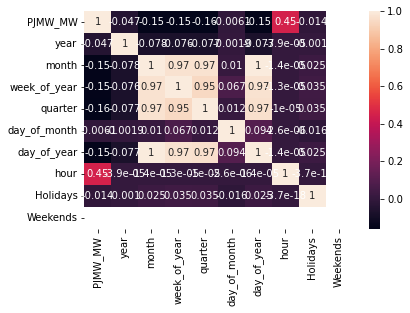

<Figure size 1440x864 with 0 Axes>

In [69]:
sns.heatmap(df.corr(),annot=True)
plt.figure(figsize = (20,12))

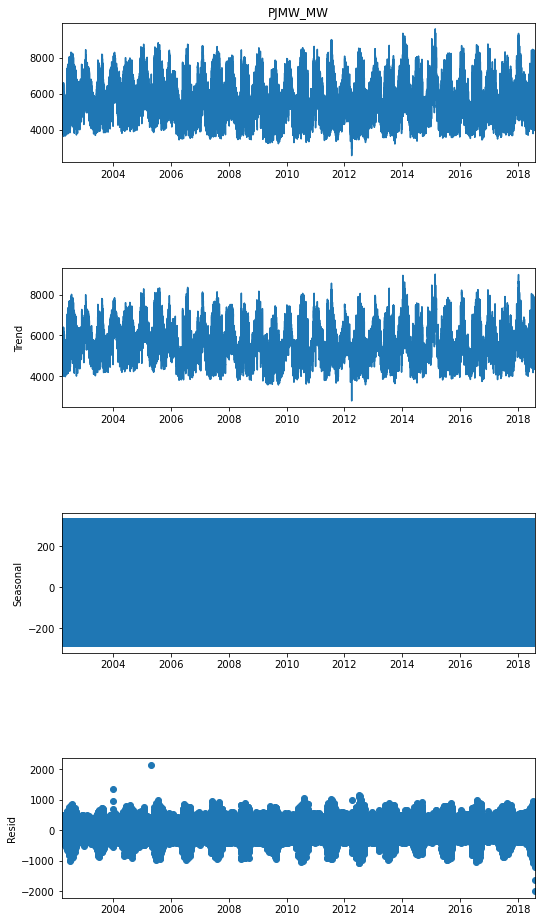

In [70]:
#Seasonal Decompose
import statsmodels.api as sm

from statsmodels.tsa.seasonal import seasonal_decompose

ts_add = seasonal_decompose(df.PJMW_MW,model="additive",extrapolate_trend = 'freq',period = 12)
fig = ts_add.plot()
fig.set_figheight(15)
fig.set_figwidth(8)
plt.show()

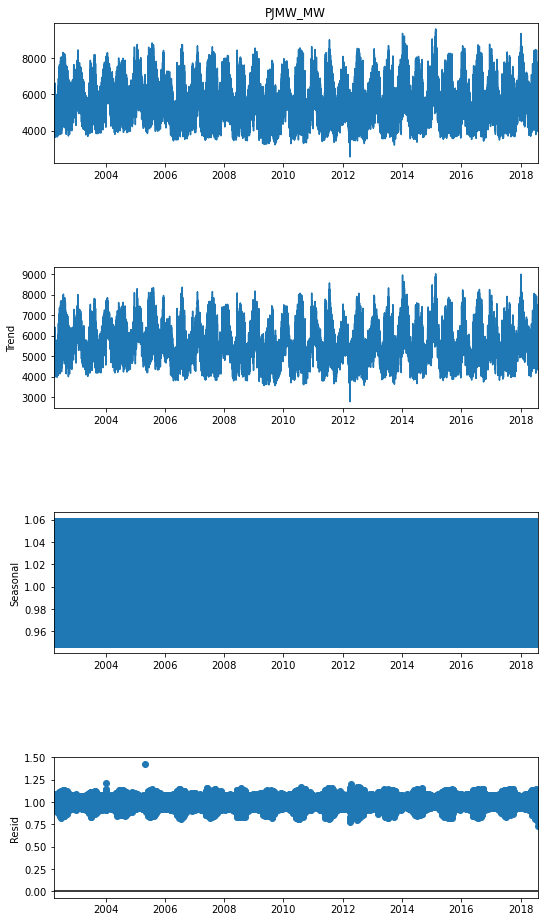

In [71]:
ts_mul = seasonal_decompose(df.PJMW_MW,model="multiplicative",extrapolate_trend = 'freq',period = 12)
fig = ts_mul.plot()
fig.set_figheight(15)
fig.set_figwidth(8)
plt.show()

## 1.convert the data into hourly to monthly basis to see the trend and seasonality

In [72]:
df = pjm_data.copy()
df

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [73]:
df_month = df.resample(rule = 'M').mean()

In [74]:
df_month

,PJMW_MW
Datetime,
2002-04-30,5170.892211
2002-05-31,5085.094086
2002-06-30,5685.681944
2002-07-31,6097.877688
2002-08-31,6063.909946
...,...
2018-04-30,5281.277778
2018-05-31,5278.620968
2018-06-30,5559.326389


### Try to see the data is stationary or not

Dickey-Fuller Test The most important assumption of auto regressive method is that the PJMW data should be stationary.

Let's run the Dicky Fuller Test on the timeseries and verify the null hypothesis that the PJMW is non-stationary.

In [75]:
def adf_test(series):
    result =adfuller(series)
    print('ADF Statistics: {}'.format(result[0]))
    print('p-values: {}'.format(result[1]))
    if result[1]<=0.05:
        print('Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary')
    else:
        print('weak avidence against the null hypothsis,time series has a unit root , indicating it is no -stationary')

In [76]:
adf_test(df_month['PJMW_MW'])

ADF Statistics: -2.8947558399261997
p-values: 0.04596122930503283
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


<AxesSubplot:xlabel='Datetime'>

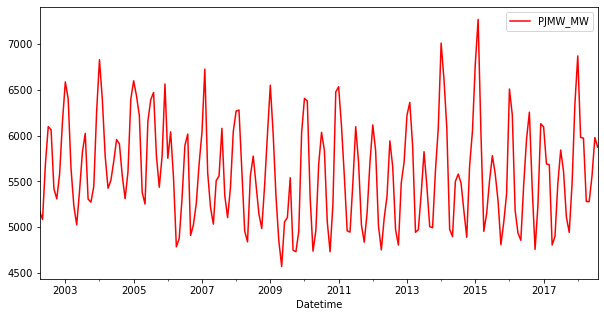

In [77]:
df_month.plot(figsize= (10,5),color='r')

In [78]:
result1=seasonal_decompose(df_month['PJMW_MW'], model='additive', period=12)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

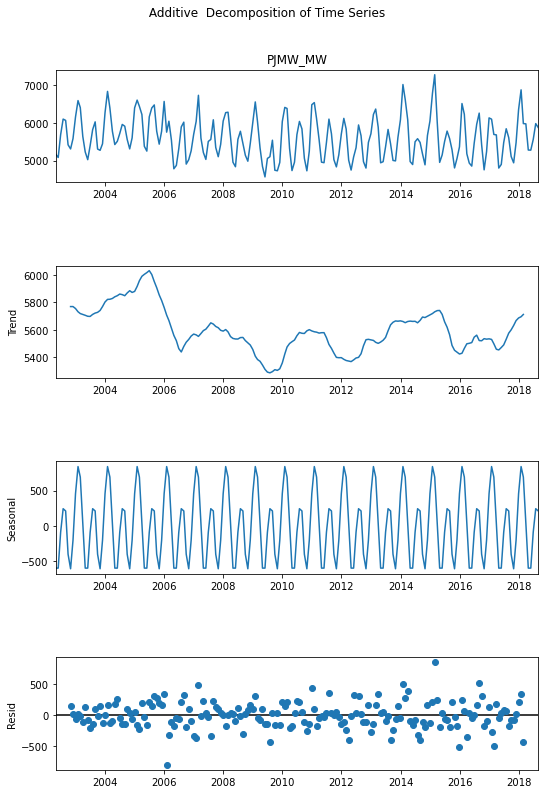

In [79]:
fig = result1.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

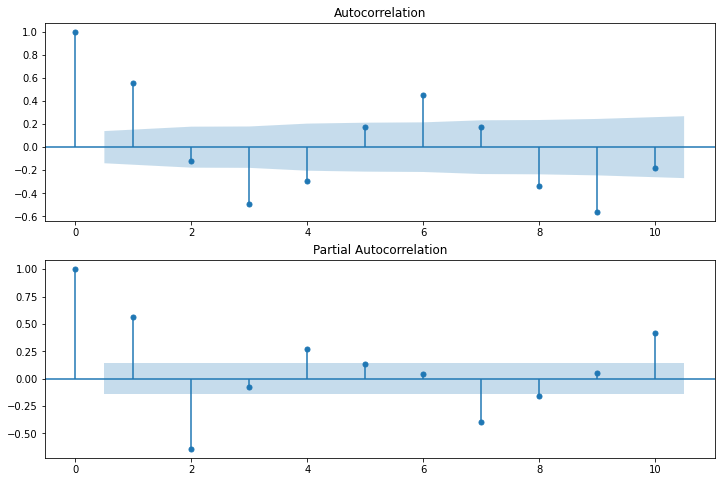

In [80]:
## seeing the acf and pacf graph for days data

fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_month['PJMW_MW'],lags=10,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_month['PJMW_MW'],lags=10,ax=ax2)


## converting the data into days

In [81]:
df_daily  = df.resample(rule = 'D').mean()
df_daily.head()

,PJMW_MW
Datetime,
2002-04-01,5271.173913
2002-04-02,5310.416667
2002-04-03,5325.916667
2002-04-04,5670.791667
2002-04-05,5686.125000


In [192]:
df_daily.to_csv(r'C:\Users\HP\1. A  project\dfdaily.csv')

In [82]:
df_daily.describe()

,PJMW_MW
count,5969.000000
mean,5602.193906
std,737.789742
min,3018.041667
25%,5043.875000
50%,5522.458333
75%,6085.750000
max,8794.583333


##  Decomposing our time series

1.Additive Model

       y(t) = Level + Trend + Seasonality + Noise
       
2. Multiplicative model

       y(t) = Level * Trend * Seasonality * Noise

In [83]:
result_add=seasonal_decompose(df_daily['PJMW_MW'], model='additive', period=365)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

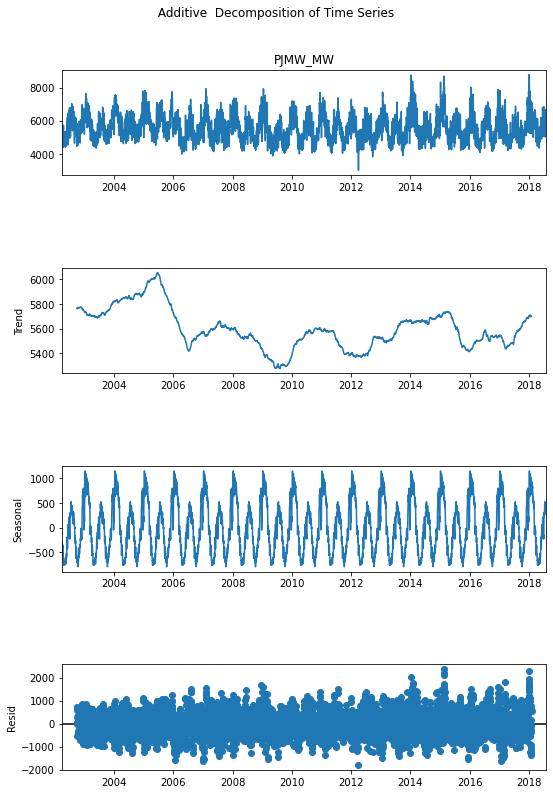

In [84]:
fig = result_add.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

In [85]:
result_mul=seasonal_decompose(df_daily['PJMW_MW'], model='mul', period=365)

Text(0.5, 0.98, ' Mulplicative  Decomposition of Time Series')

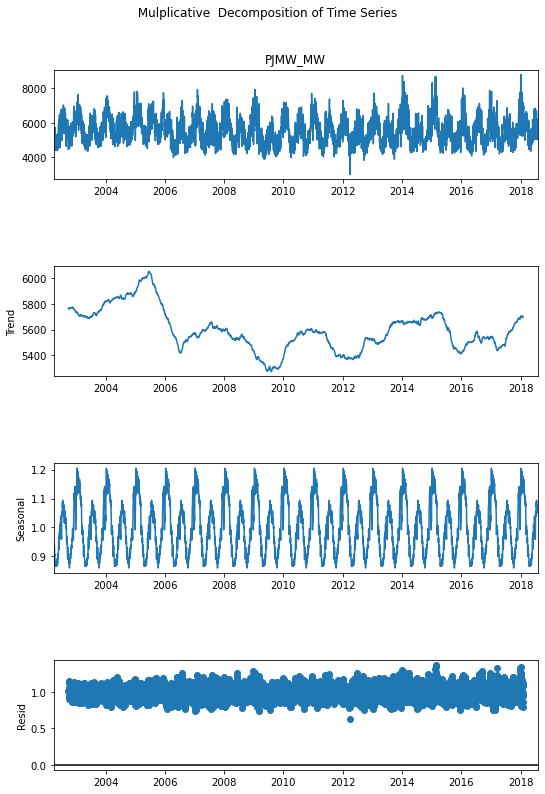

In [86]:
fig = result_mul.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Mulplicative  Decomposition of Time Series')

### statistical test for mean and std deviation

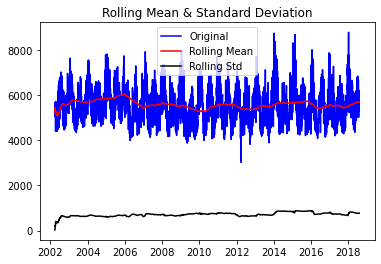

ADF Statistics: -7.265243483352551
p-values: 1.6415165880027295e-10
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [87]:
#Determing rolling statistics for yearly basis
   
rolmean =df_daily['PJMW_MW'] .rolling(window=365,min_periods=1).mean()
    
rolstd =df_daily['PJMW_MW'].rolling(window=365,min_periods=1).std()


 #Plot rolling statistics:
orig = plt.plot(df_daily, color='blue',label='Original')
mean = plt.plot(rolmean, color='red', label='Rolling Mean')
std = plt.plot(rolstd, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)
adf_test(df_daily['PJMW_MW'])

In [88]:
result_mul=seasonal_decompose(rolmean.dropna(), model='mul',period=365)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

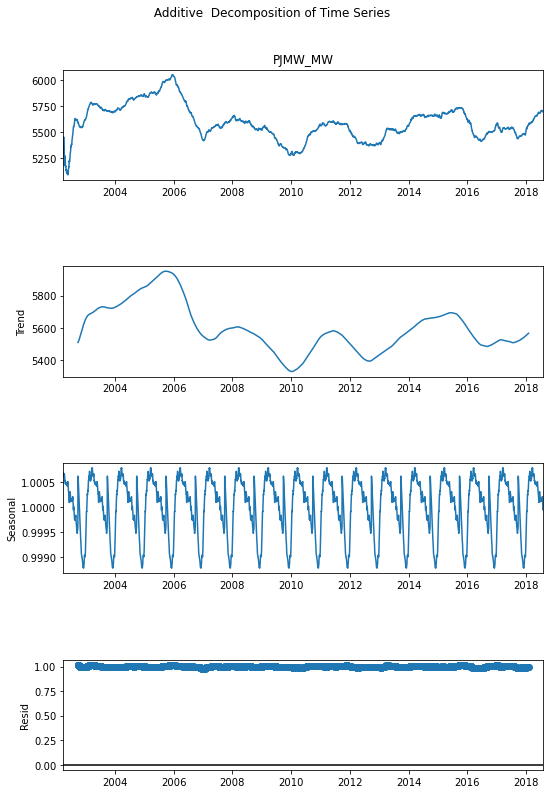

In [89]:
fig = result_mul.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

In [90]:
#ACF and PACF plots:
from statsmodels.tsa.stattools import acf, pacf 

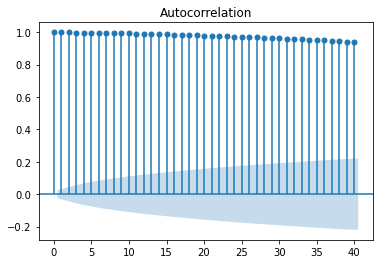

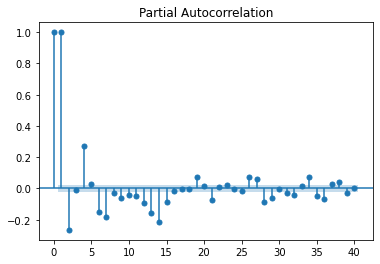

In [91]:
lag_acf = plot_acf(rolmean.dropna(), lags=40)
lag_pacf = plot_pacf(rolmean.dropna(), lags=40)

### shifting method for 365 days

ADF Statistics: -7.944404396490974
p-values: 3.2489668723080726e-12
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


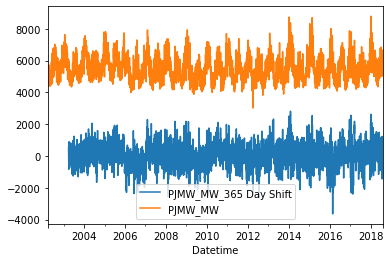

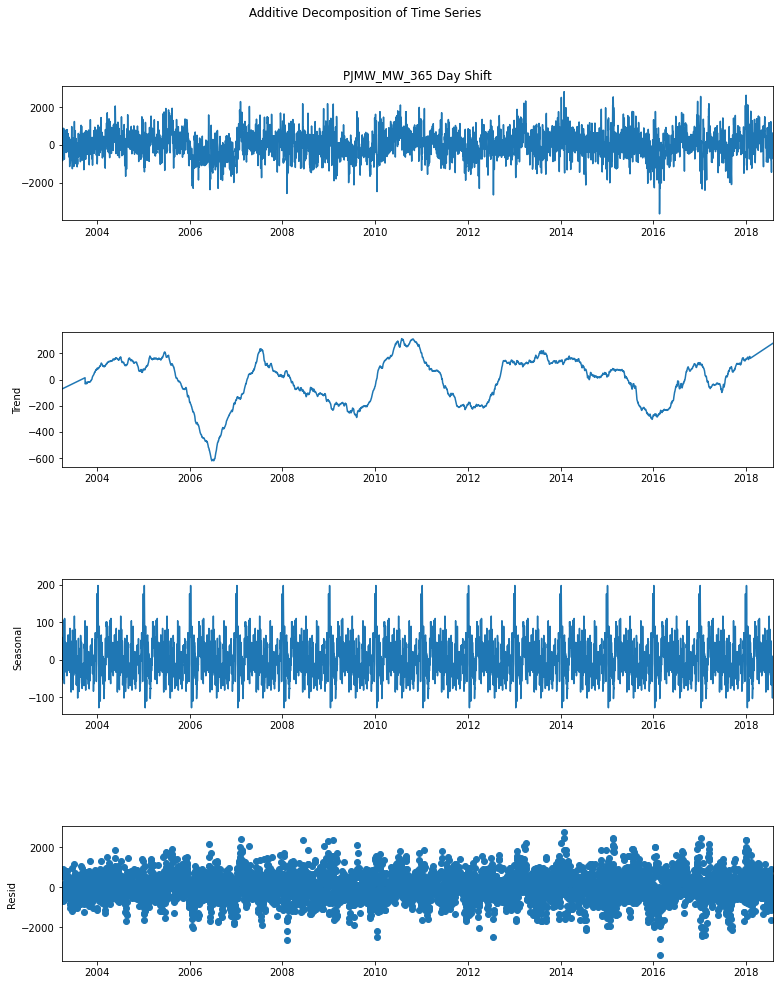

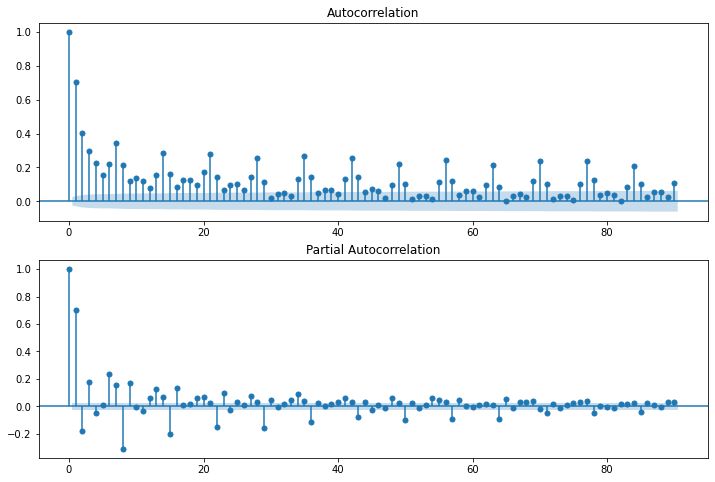

In [92]:
df_daily['PJMW_MW_365 Day Shift'] = df_daily['PJMW_MW']- df_daily['PJMW_MW'].shift(365)


## Again test dickey fuller test after changing to daily 365 day shift
adf_test(df_daily['PJMW_MW_365 Day Shift'].dropna())


df_daily[['PJMW_MW_365 Day Shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_365 Day Shift'].dropna(),model="addative",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_365 Day Shift'].dropna(),lags=90,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_365 Day Shift'].dropna(),lags=90,ax=ax2)

### shifting method for 30 days

ADF Statistics: -9.193693067246597
p-values: 2.0901318753862318e-15
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


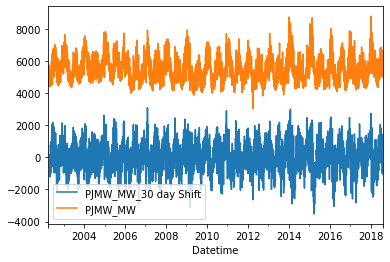

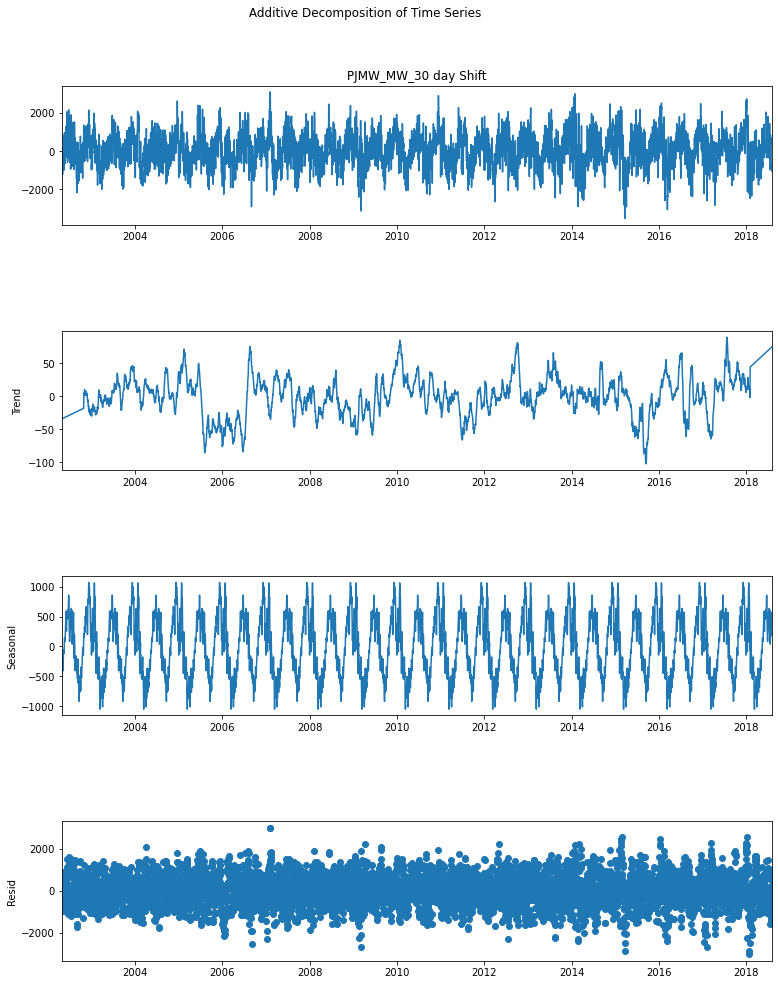

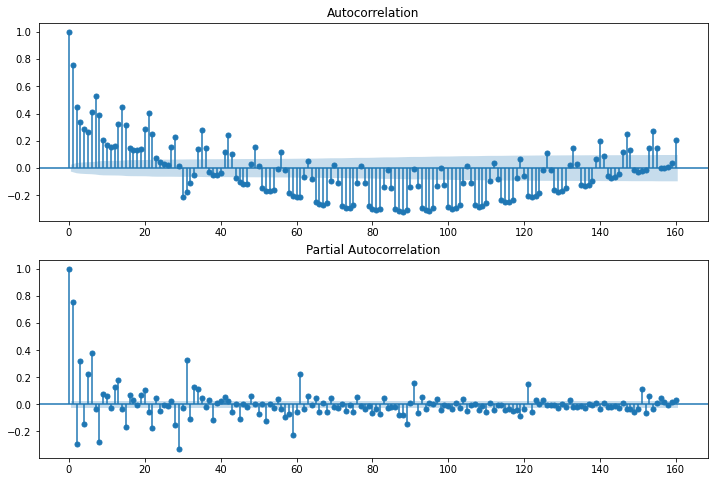

In [93]:
df_daily['PJMW_MW_30 day Shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(30)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_30 day Shift'].dropna())


df_daily[['PJMW_MW_30 day Shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_30 day Shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_30 day Shift'].dropna(),lags=160,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_30 day Shift'].dropna(),lags=160,ax=ax2)

### 120 days shifting

ADF Statistics: -7.607002854811055
p-values: 2.30804378284343e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


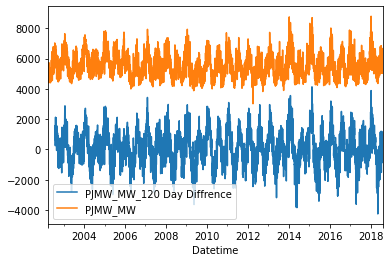

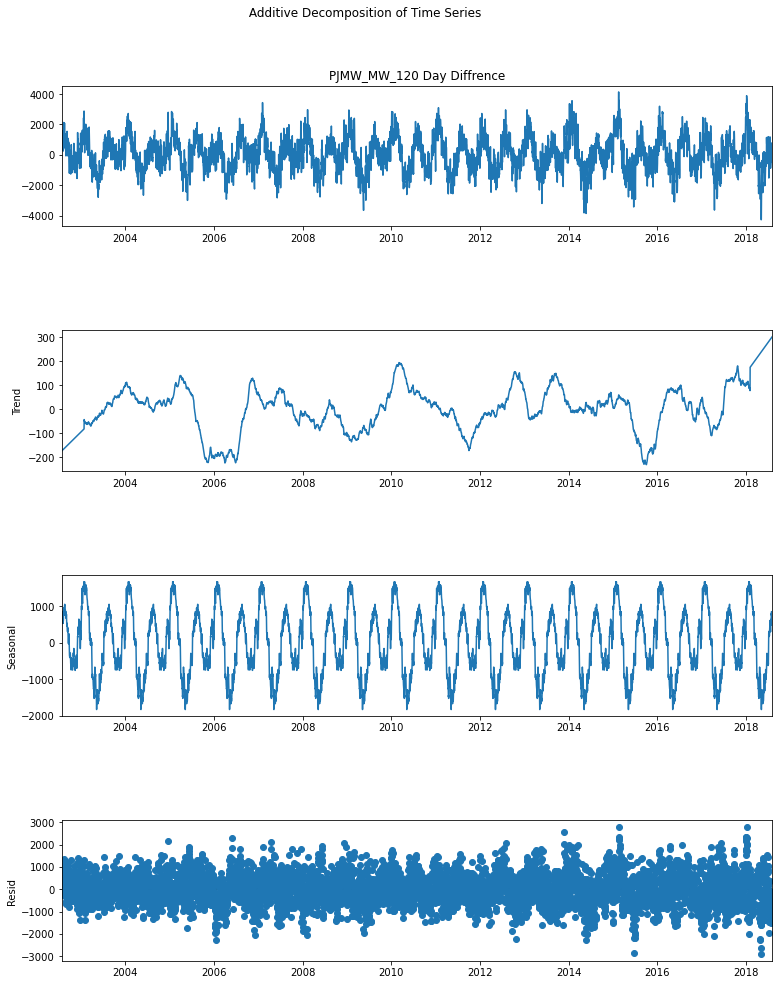

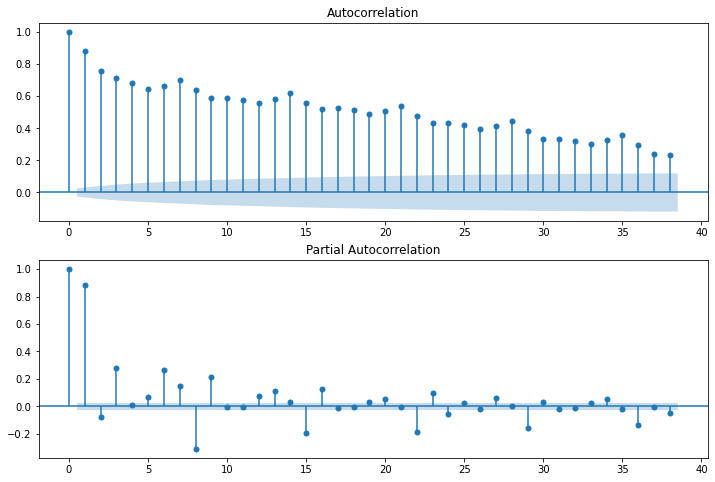

In [94]:
df_daily['PJMW_MW_120 Day Diffrence'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(120)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_120 Day Diffrence'].dropna())


df_daily[['PJMW_MW_120 Day Diffrence','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),ax=ax2)

### 7 days shifting

ADF Statistics: -13.975138579719898
p-values: 4.275218434205481e-26
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


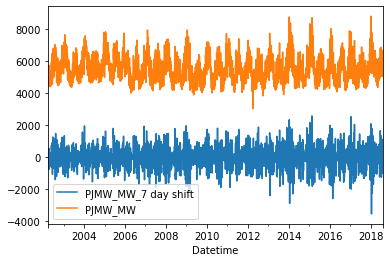

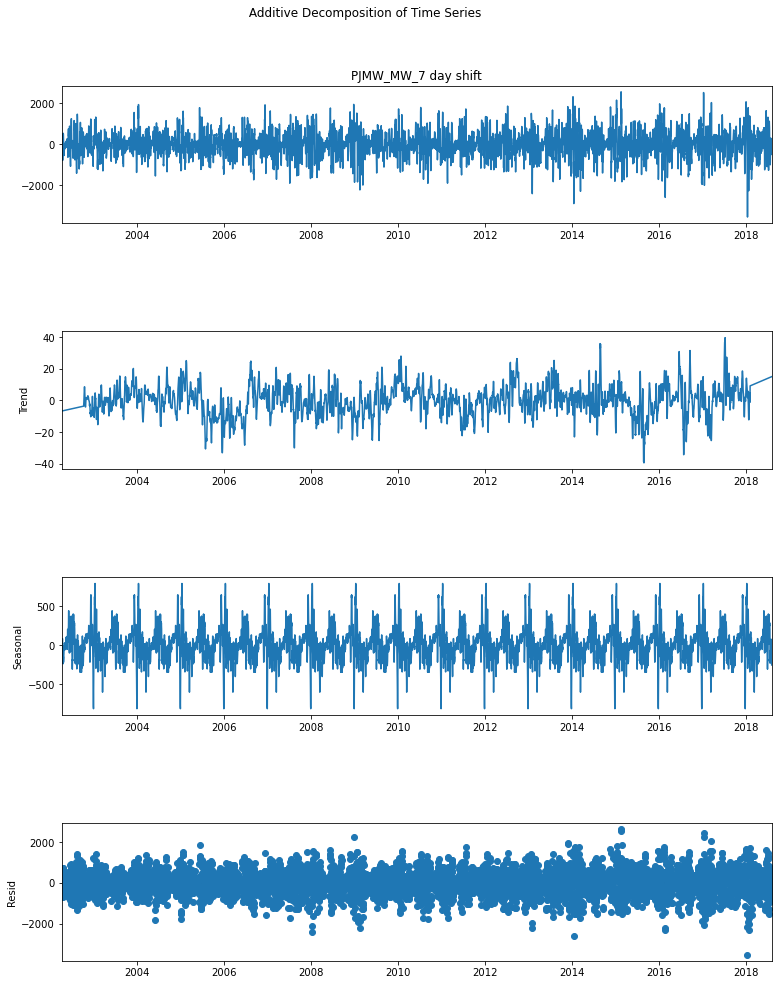

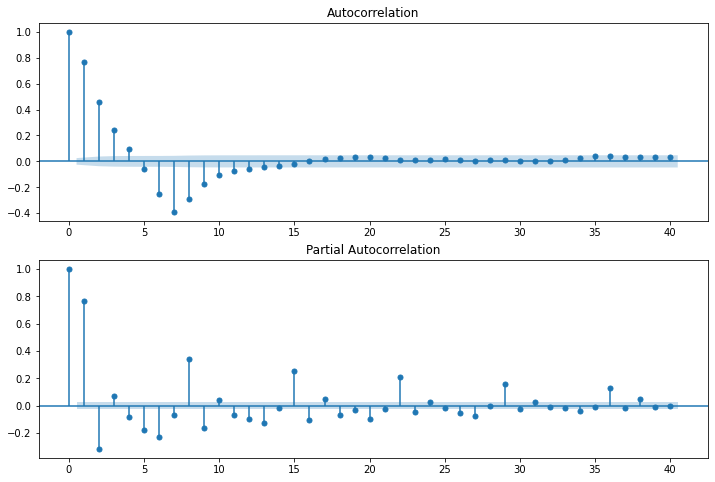

In [95]:
df_daily['PJMW_MW_7 day shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(7)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_7 day shift'].dropna())


df_daily[['PJMW_MW_7 day shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_7 day shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_7 day shift'].dropna(),lags=40,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_7 day shift'].dropna(),lags=40,ax=ax2)

### 1 days shifting

ADF Statistics: -14.396915449535339
p-values: 8.636781700463826e-27
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


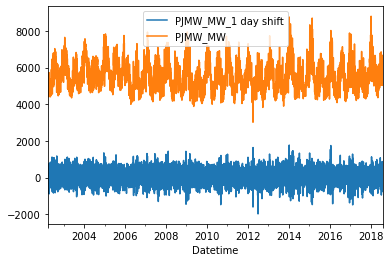

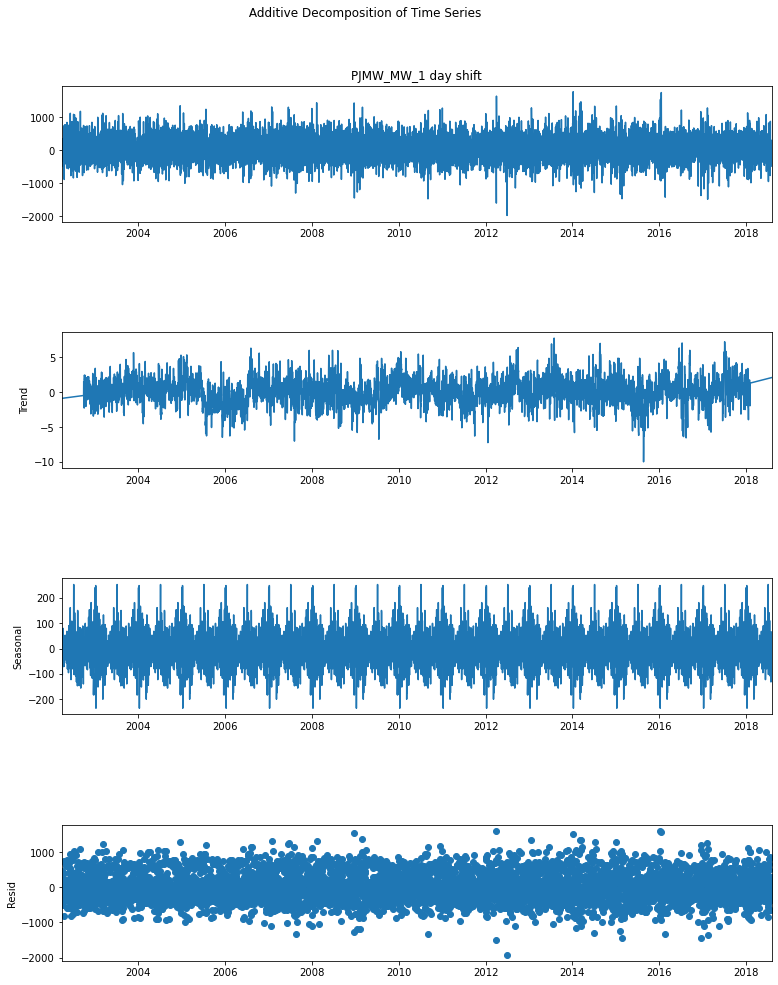

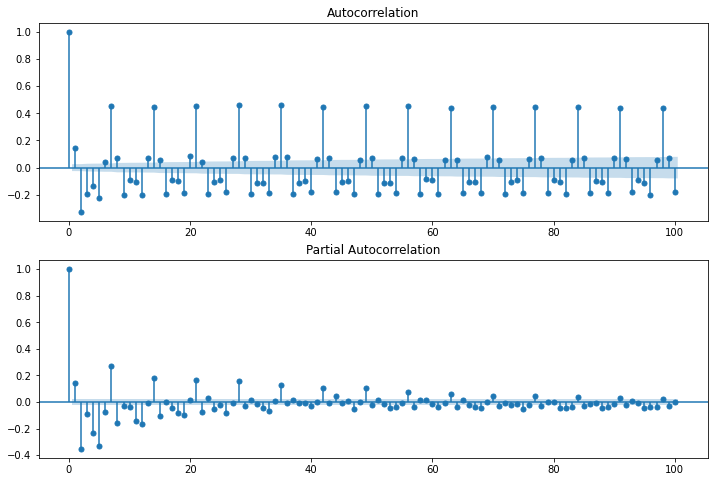

In [96]:
df_daily['PJMW_MW_1 day shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift()


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_1 day shift'].dropna())


df_daily[['PJMW_MW_1 day shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_1 day shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_1 day shift'].dropna(),lags=100,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_1 day shift'].dropna(),lags=100,ax=ax2)

### Differencing method

Text(0.5, 1.0, '2nd Order Differencing')

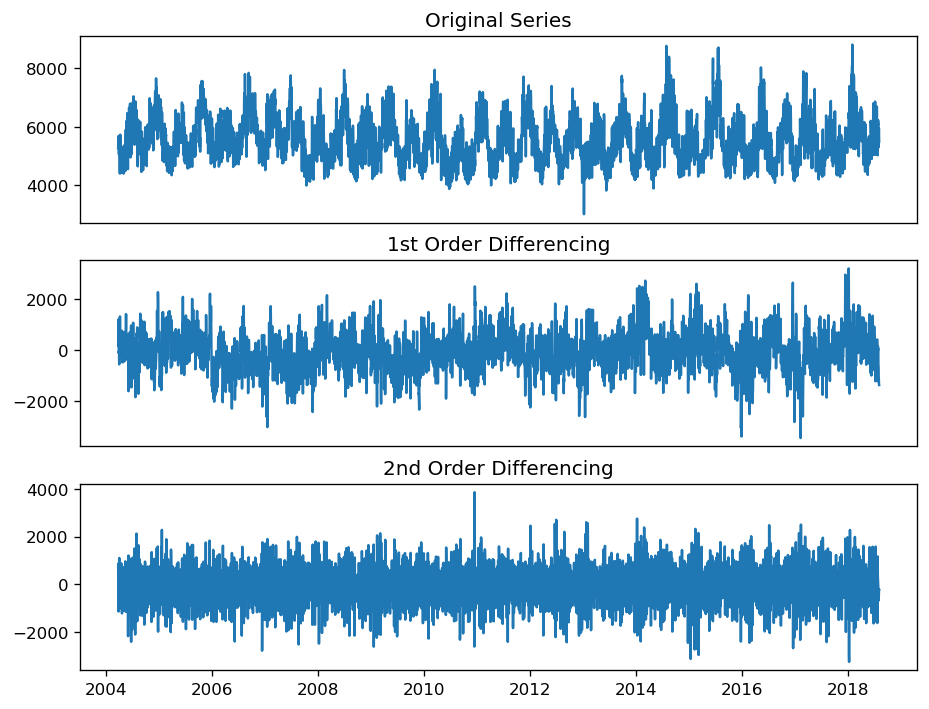

In [97]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(720)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(720).diff(2)); ax3.set_title('2nd Order Differencing')

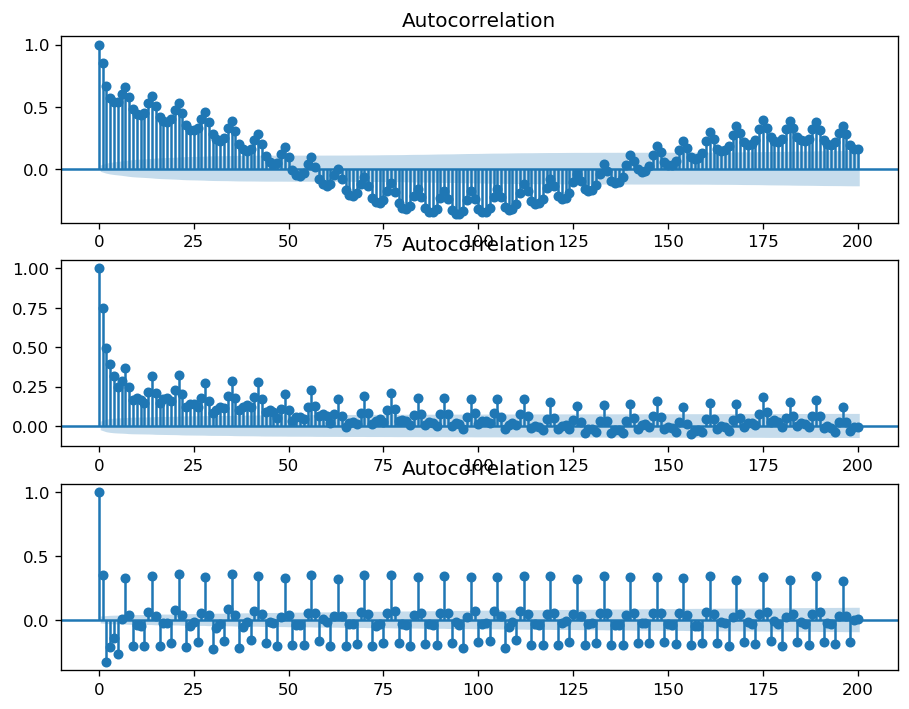

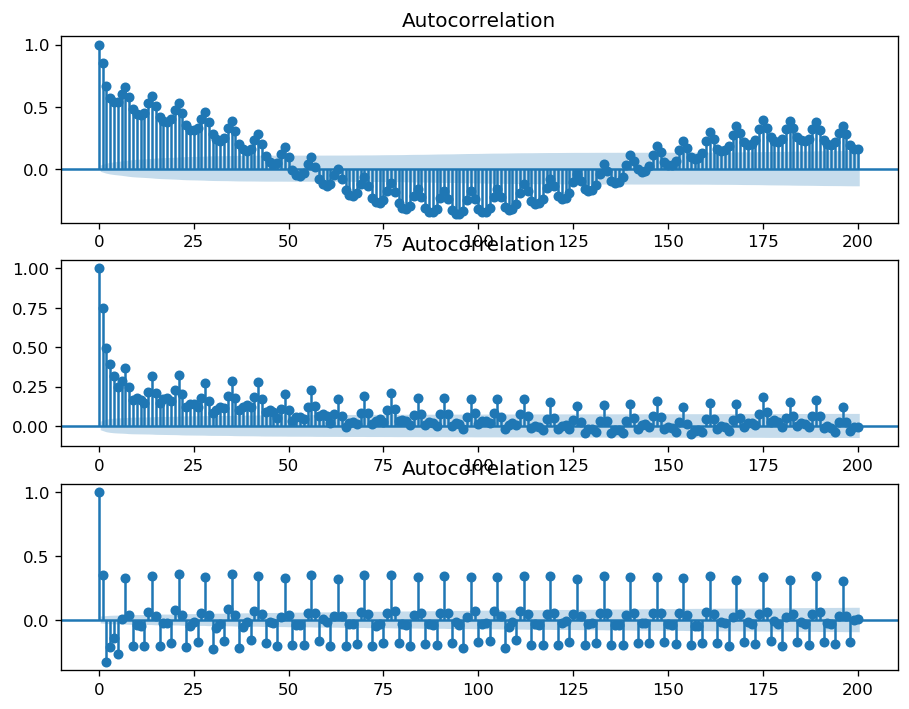

In [98]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=200)
plot_acf(df_daily.PJMW_MW.diff(720).dropna(), ax=ax2,lags=200)
plot_acf(df_daily.PJMW_MW.diff(720).diff(2).dropna(), ax=ax3,lags=200)

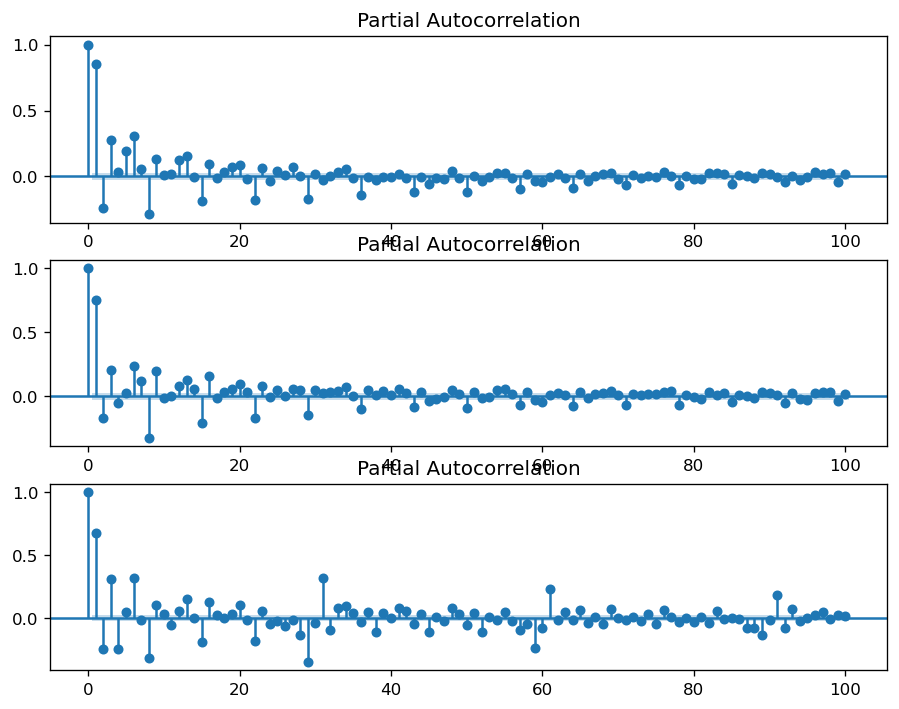

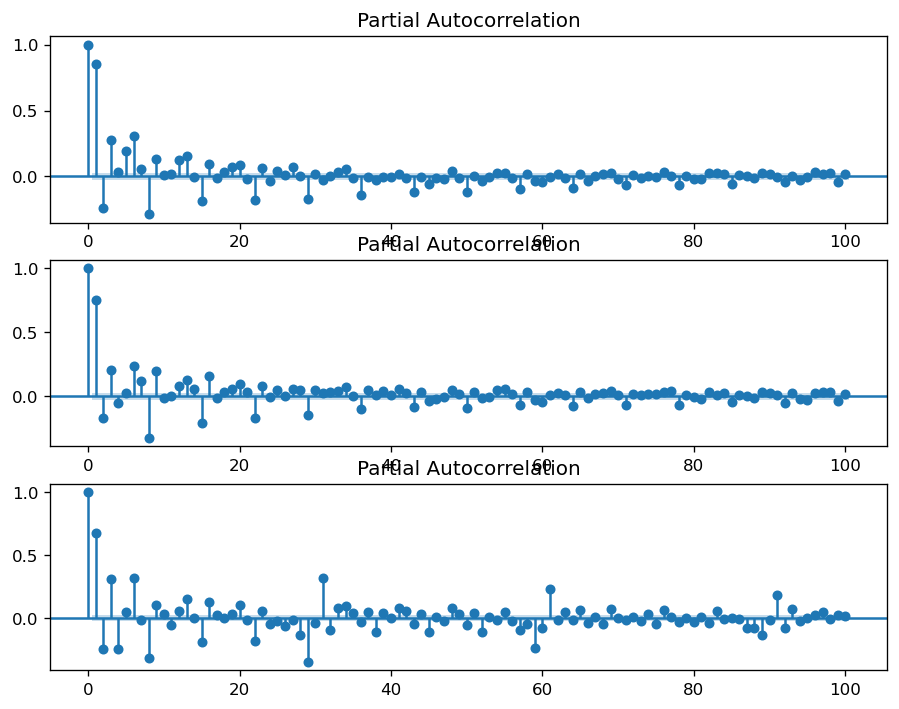

In [99]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(720).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(720).diff(30).dropna(), ax=ax3,lags=100)

Text(0.5, 1.0, '2nd Order Differencing')

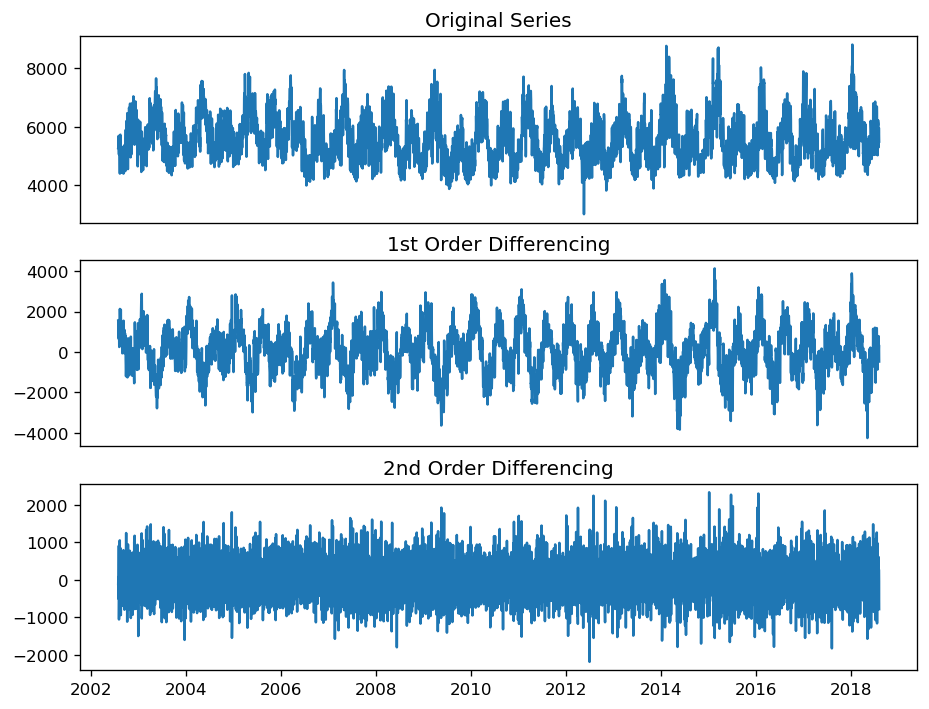

In [100]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(120)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(120).diff()); ax3.set_title('2nd Order Differencing')

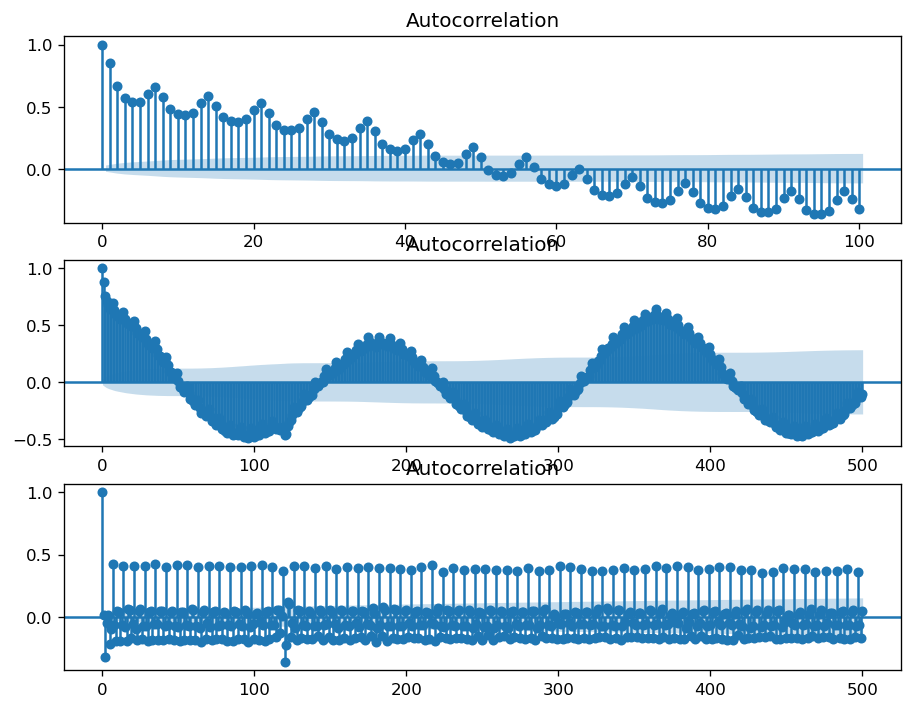

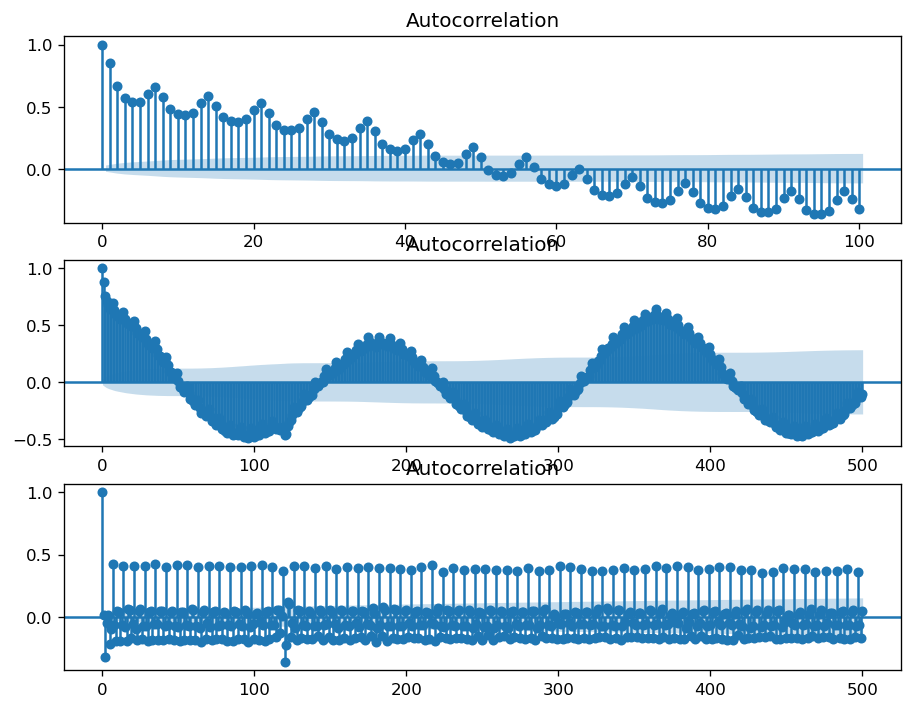

In [101]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_acf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=500)
plot_acf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=500)

Text(0.5, 1.0, '2nd Order Differencing')

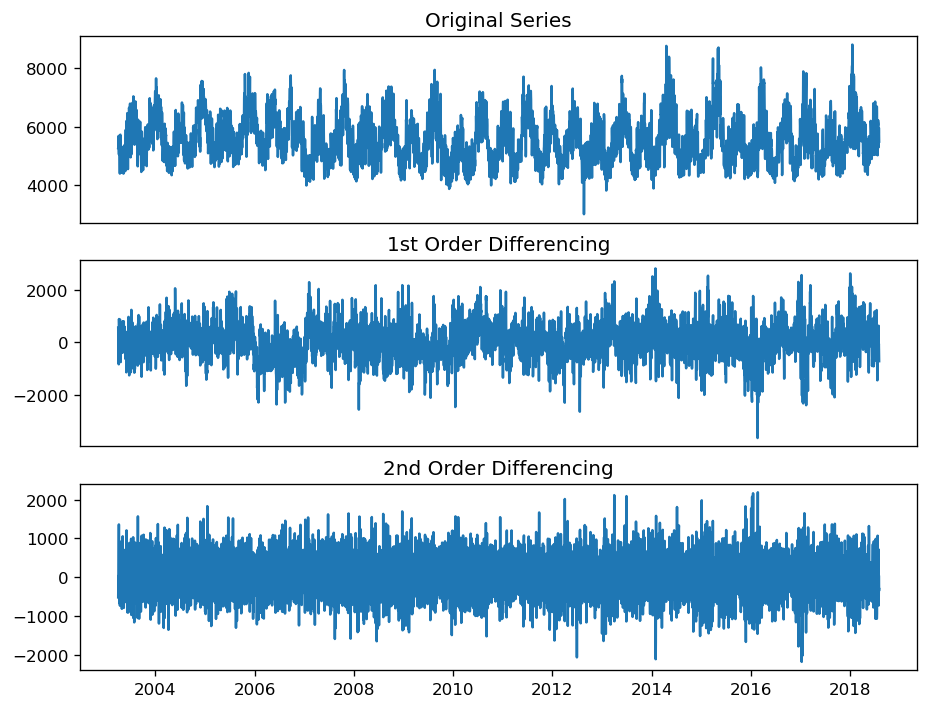

In [102]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(365)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(365).diff()); ax3.set_title('2nd Order Differencing')

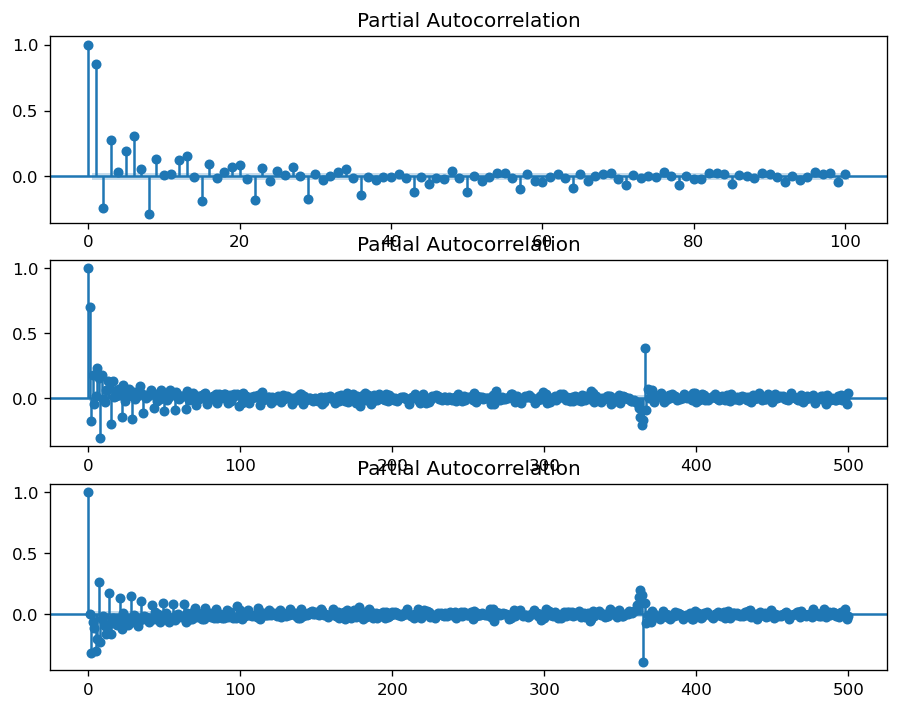

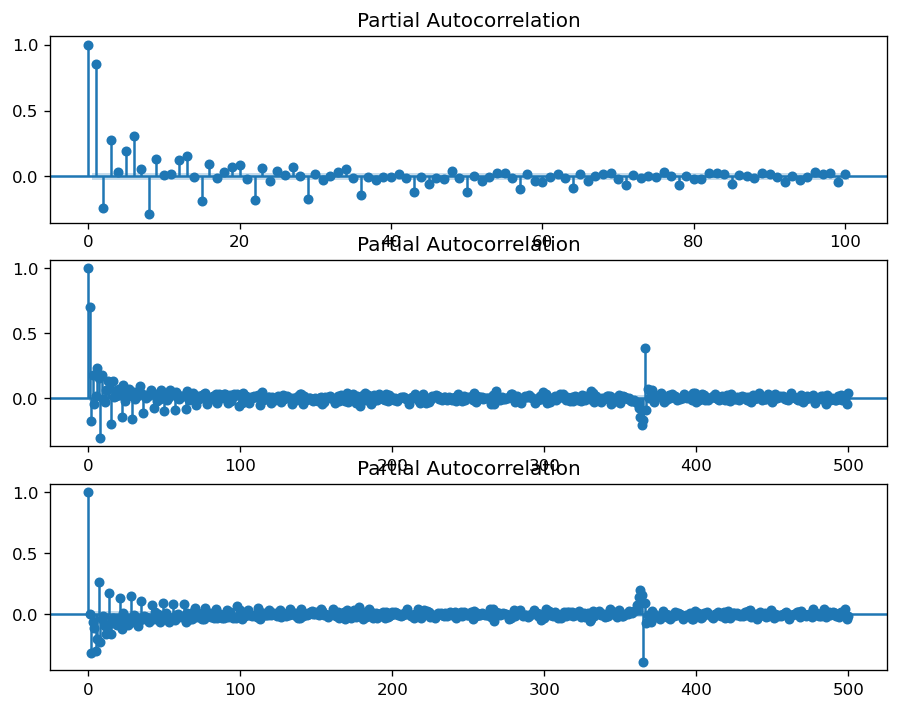

In [103]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(365).dropna(), ax=ax2,lags=500)
plot_pacf(df_daily.PJMW_MW.diff(365).diff().dropna(), ax=ax3,lags=500)


Text(0.5, 1.0, '2nd Order Differencing')

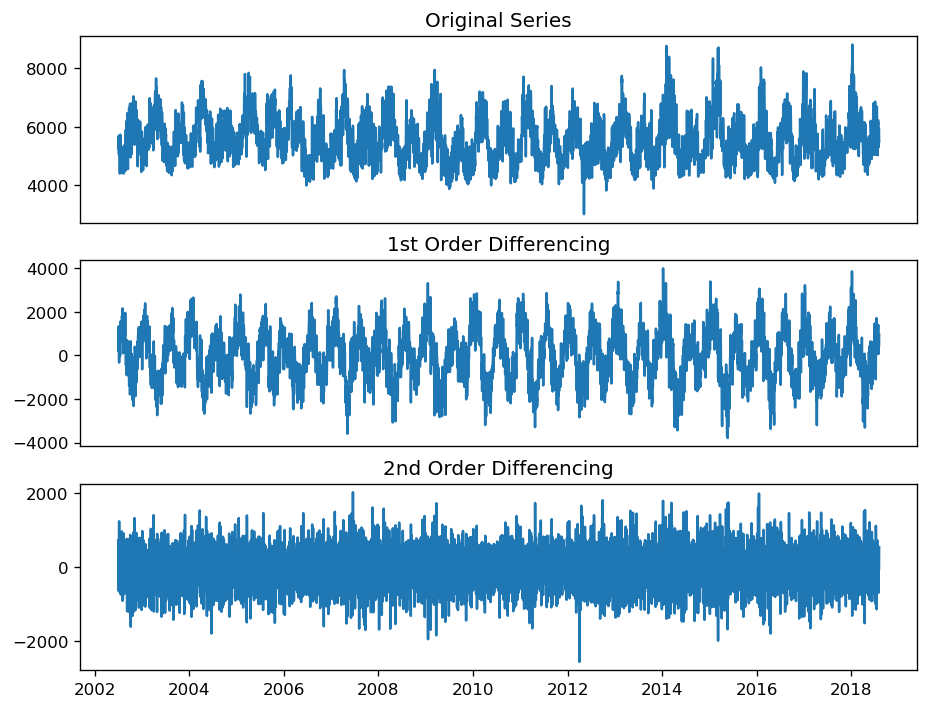

In [104]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(90)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(90).diff()); ax3.set_title('2nd Order Differencing')

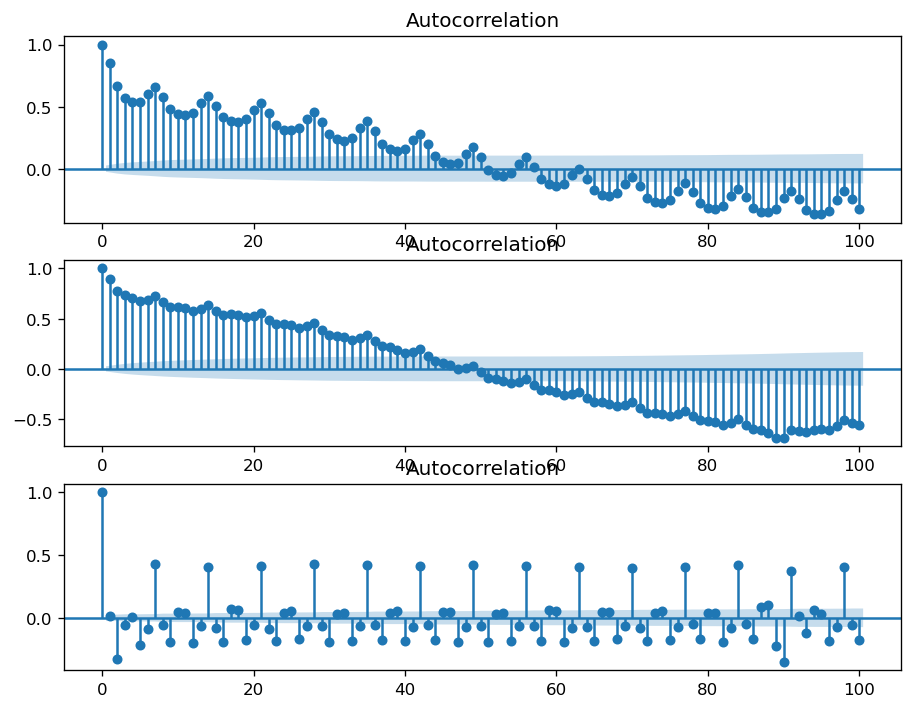

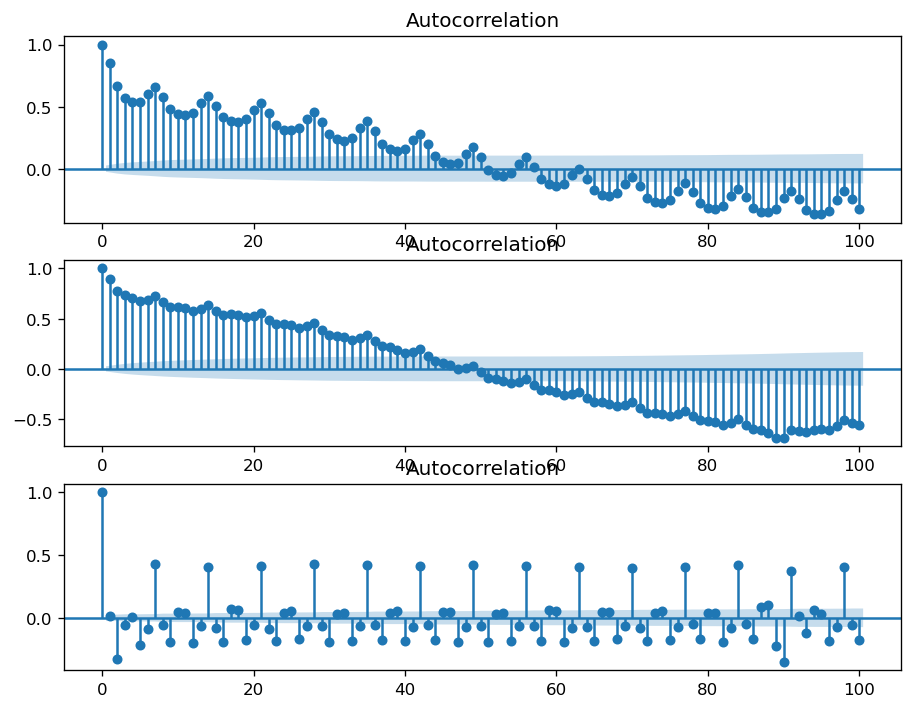

In [105]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_acf(df_daily.PJMW_MW.diff(90).dropna(), ax=ax2,lags=100)
plot_acf(df_daily.PJMW_MW.diff(90).diff().dropna(), ax=ax3,lags=100)

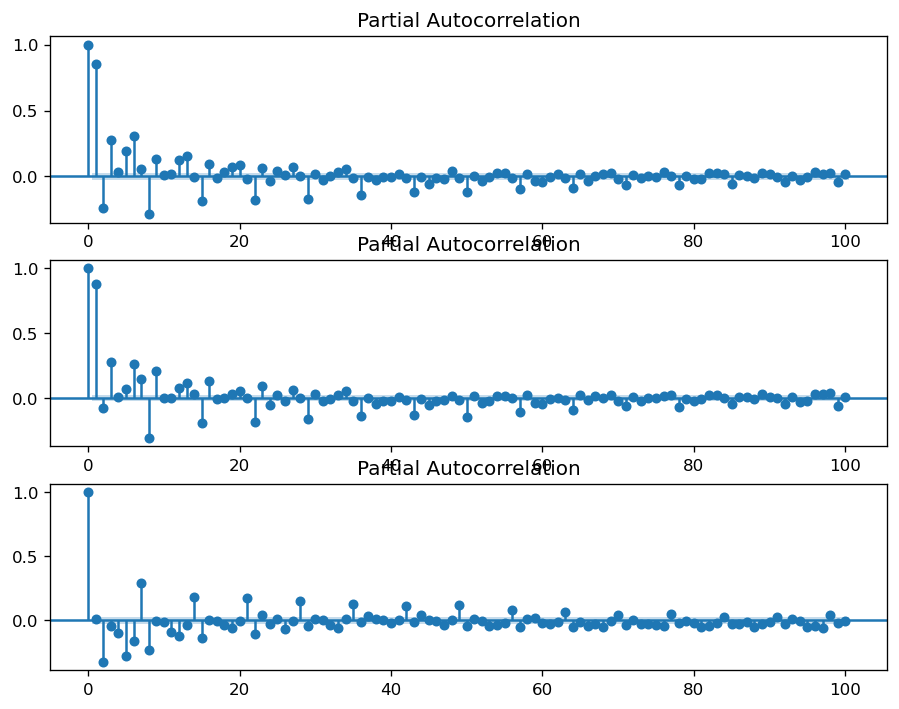

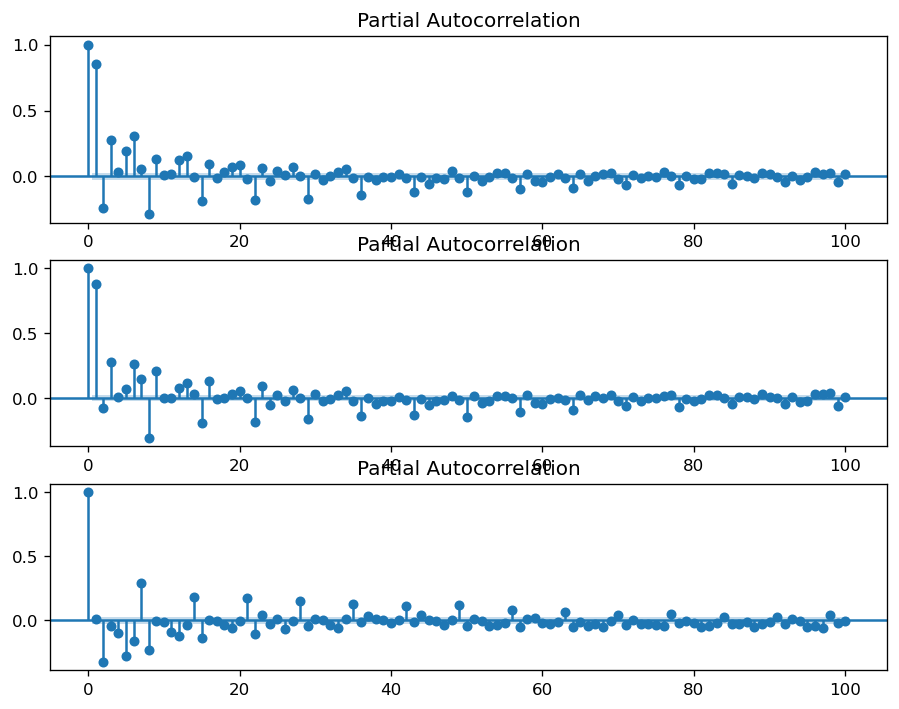

In [106]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=100)

Text(0.5, 1.0, '2nd Order Differencing')

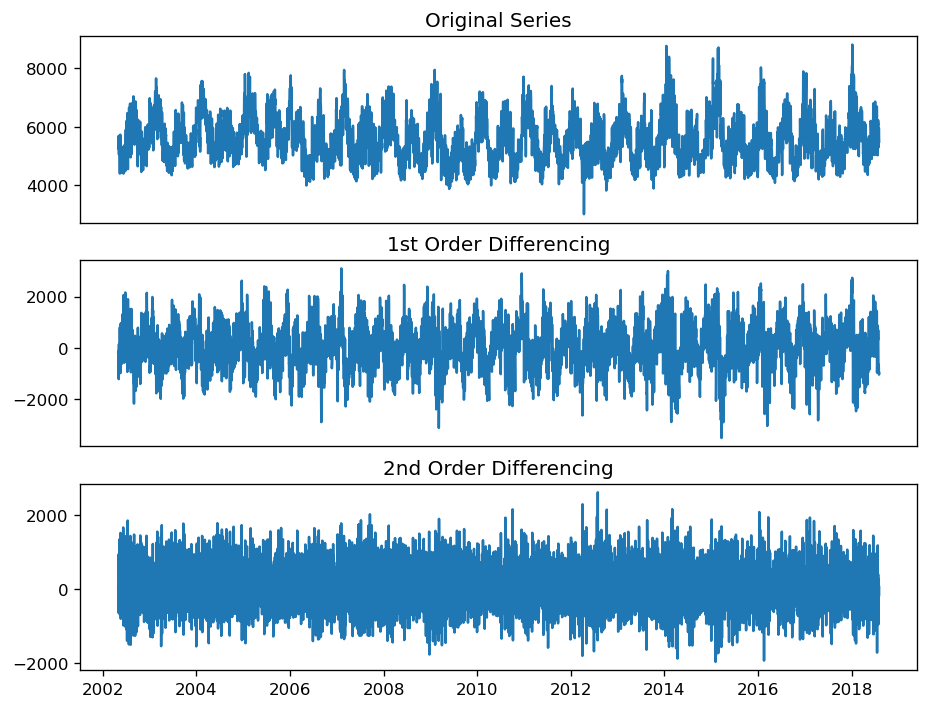

In [107]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(30)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(30).diff()); ax3.set_title('2nd Order Differencing')

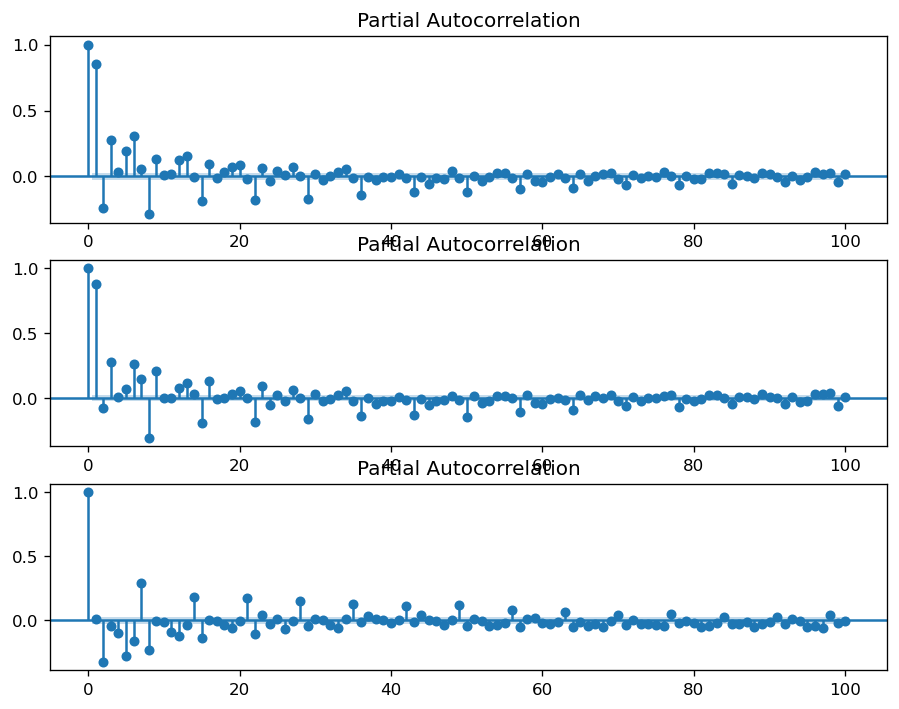

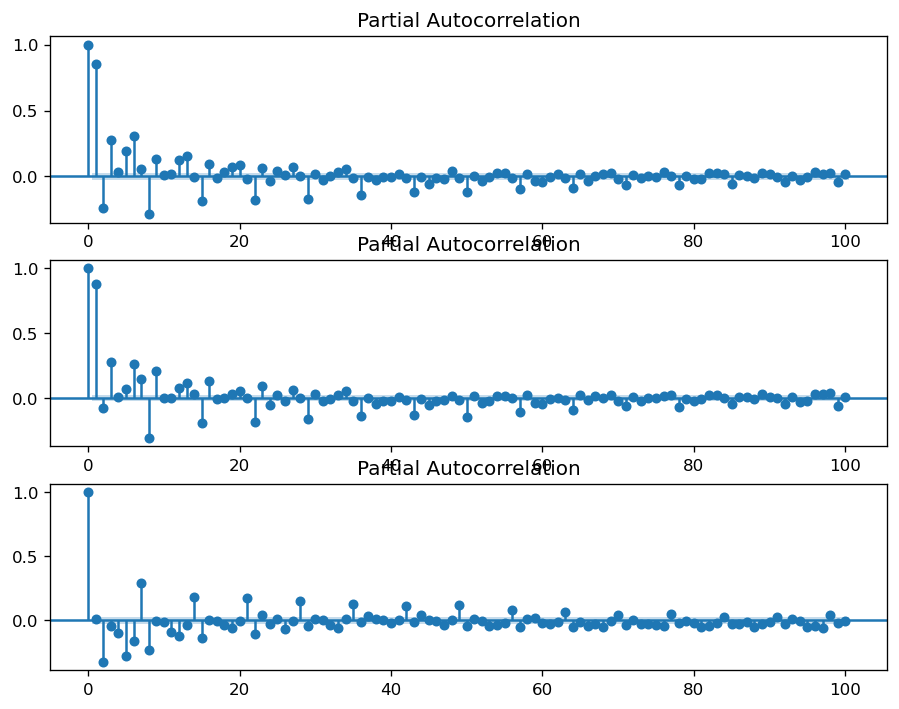

In [108]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=100)

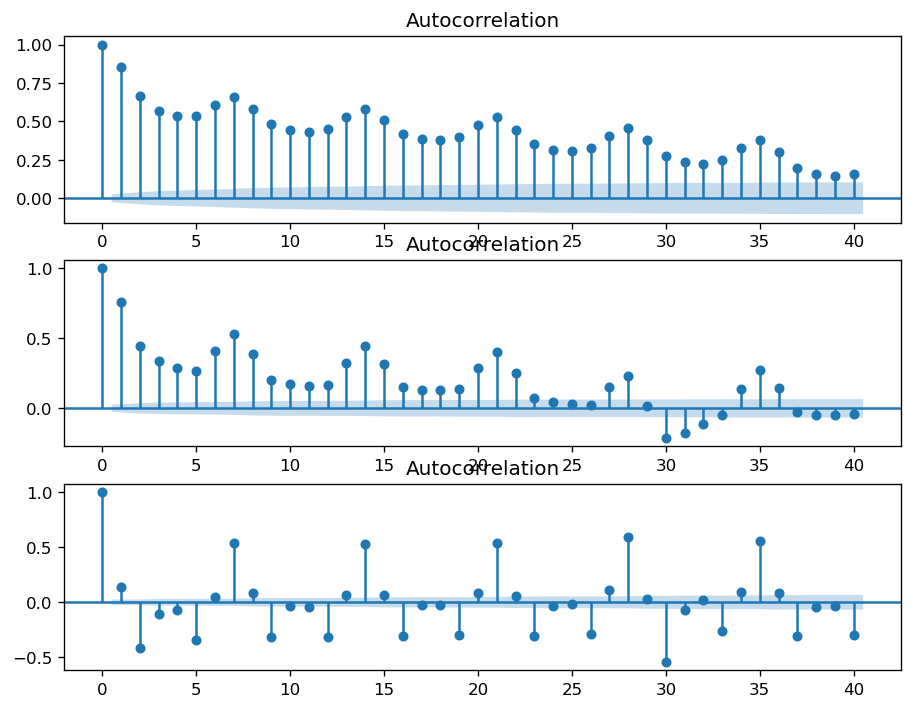

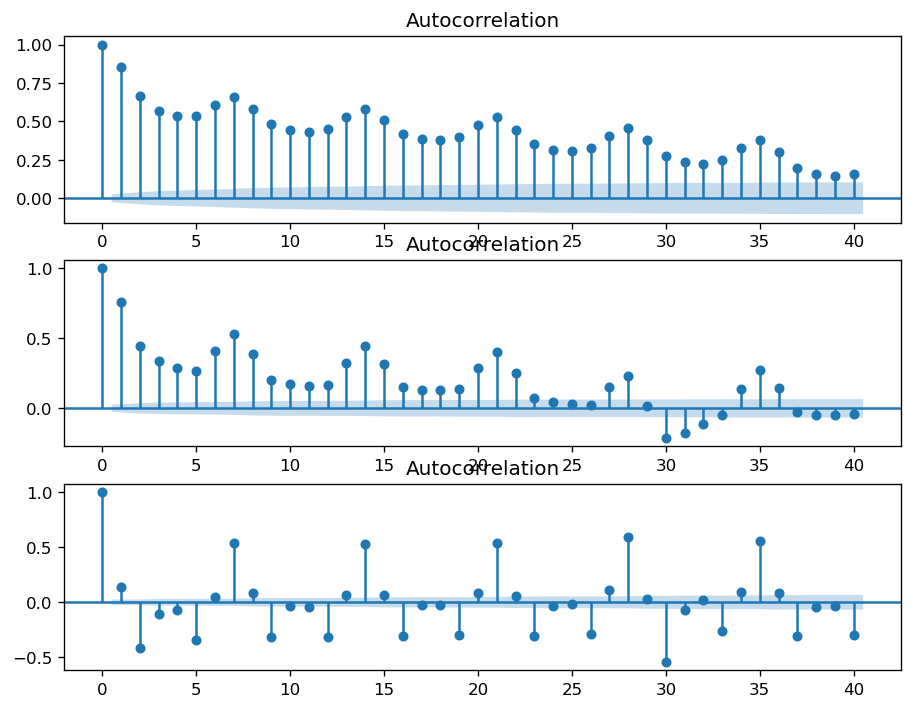

In [109]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).diff().dropna(), ax=ax3,lags=40)

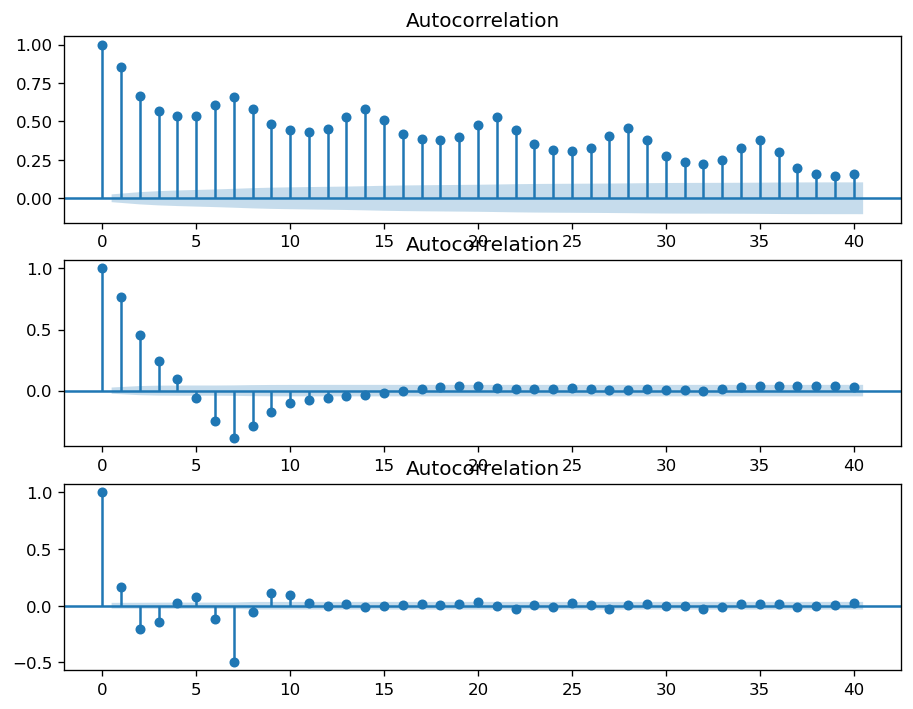

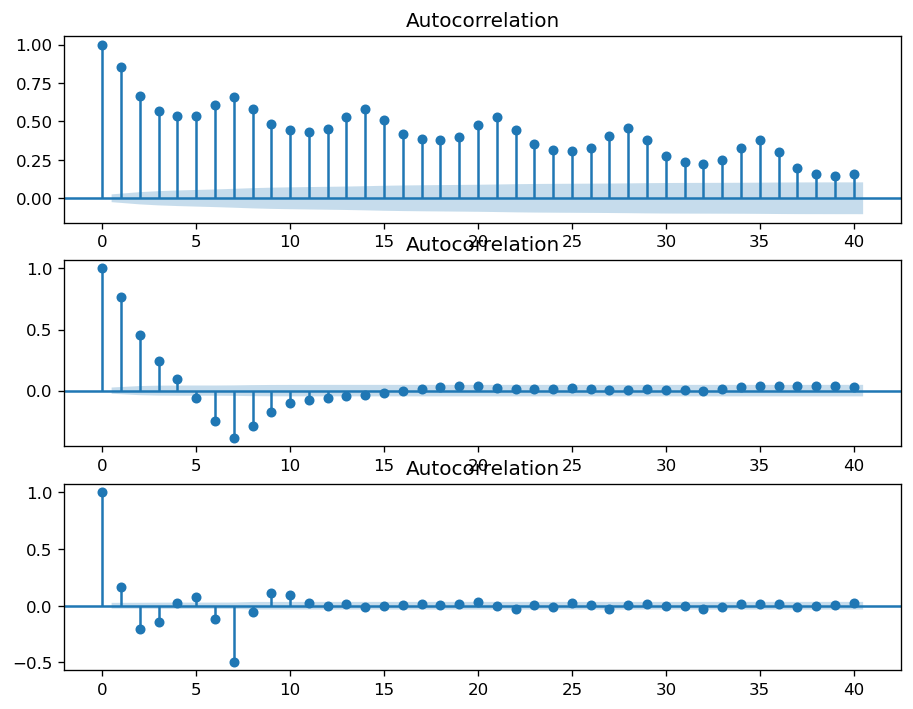

In [110]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).diff().dropna(), ax=ax3,lags=40)

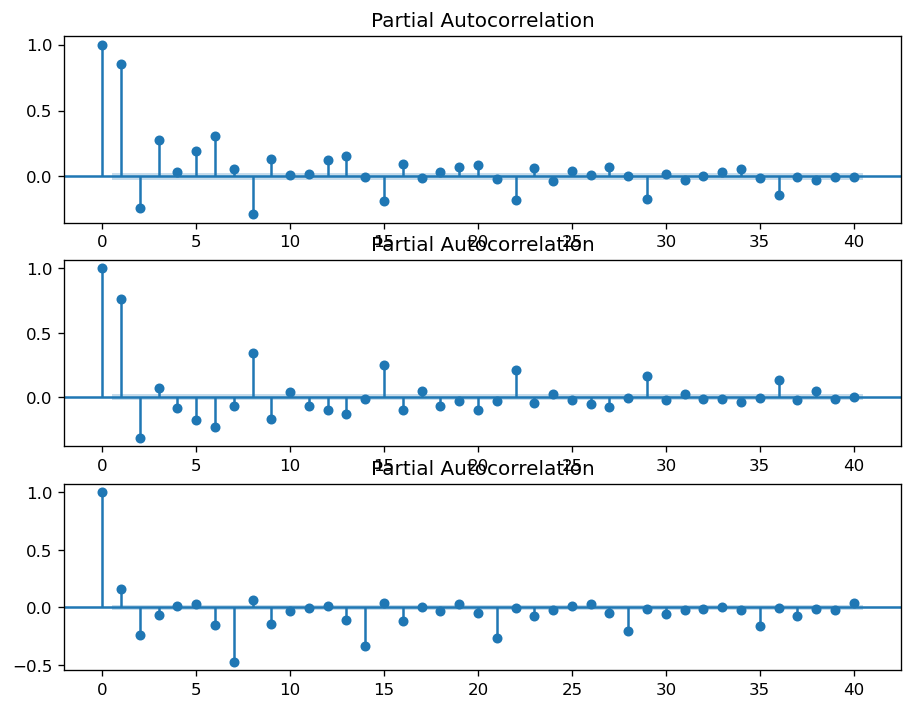

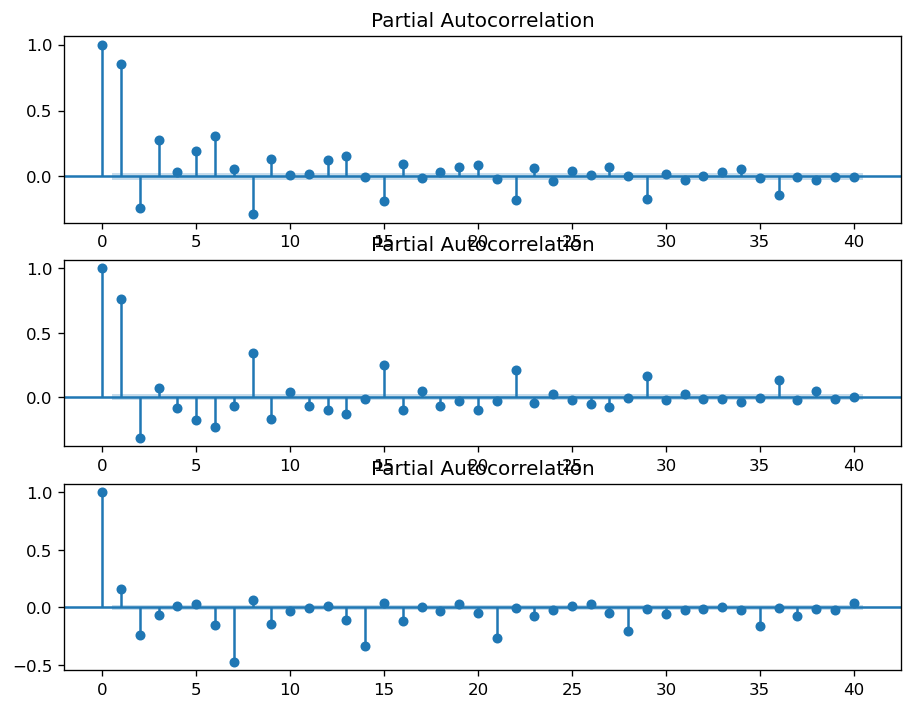

In [111]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(7).diff().dropna(), ax=ax3,lags=40)

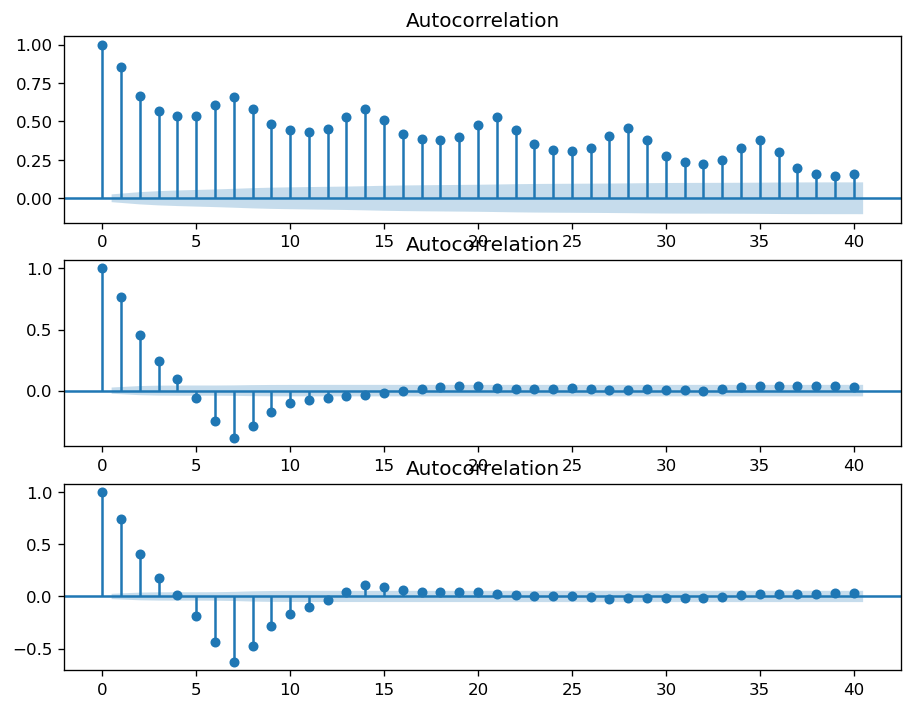

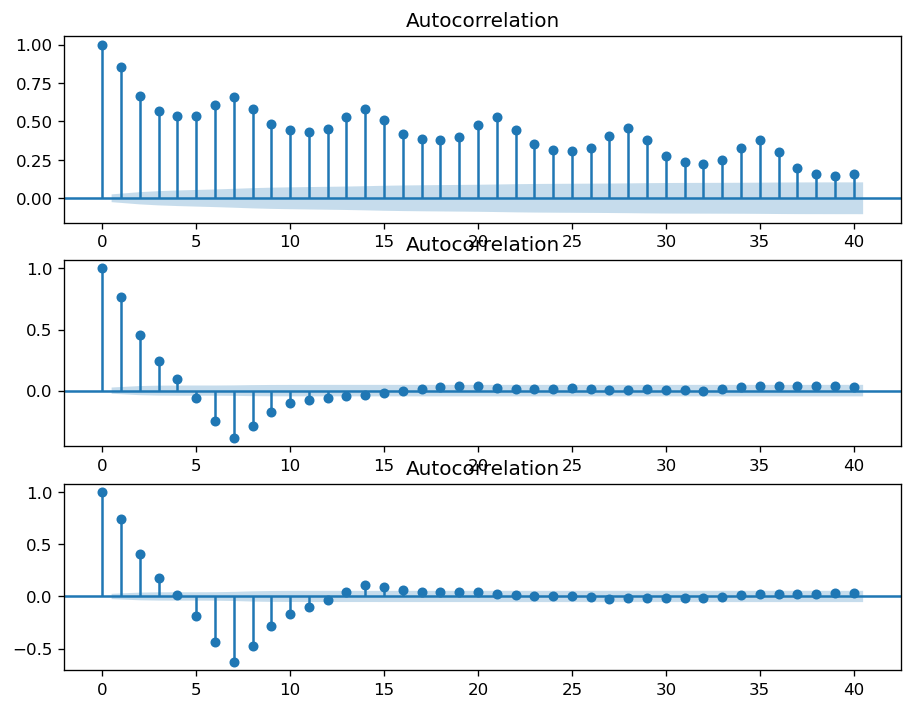

In [112]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).diff(7).dropna(), ax=ax3,lags=40)

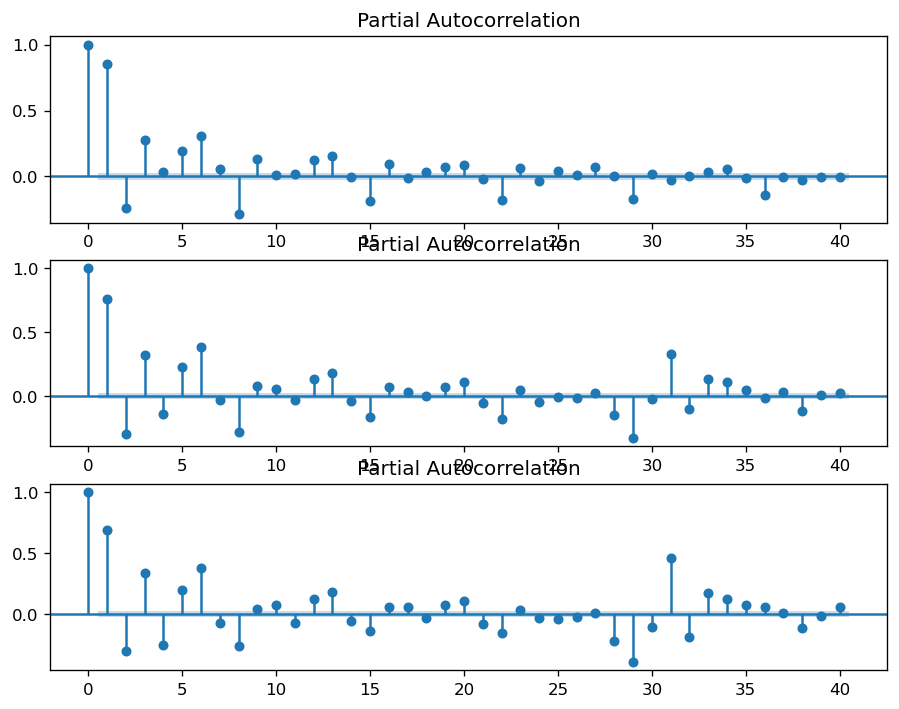

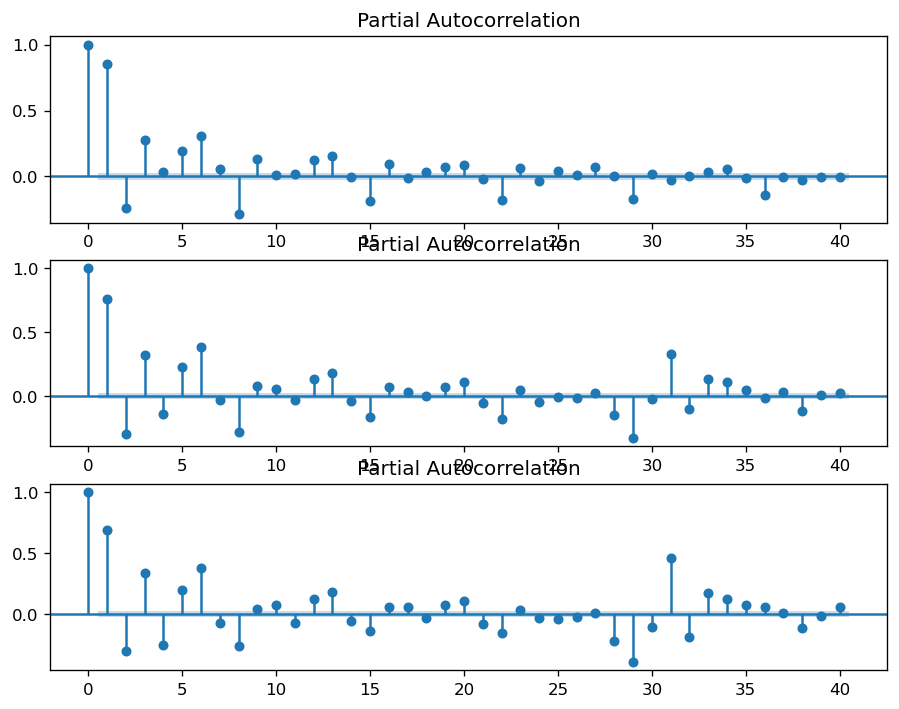

In [113]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(30).dropna(), ax=ax2,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(30).diff(30).dropna(), ax=ax3,lags=40)

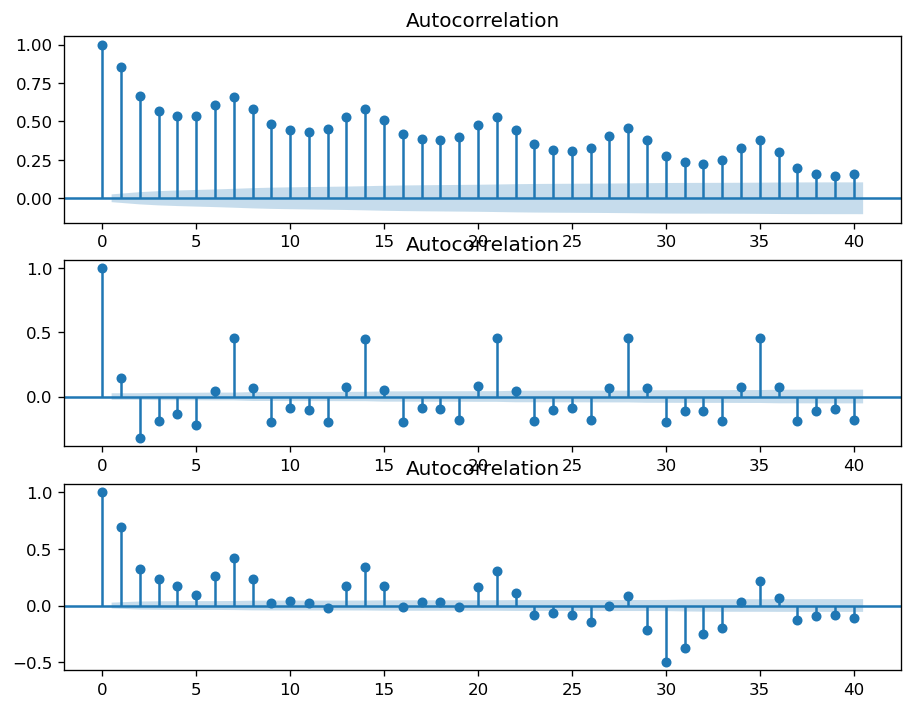

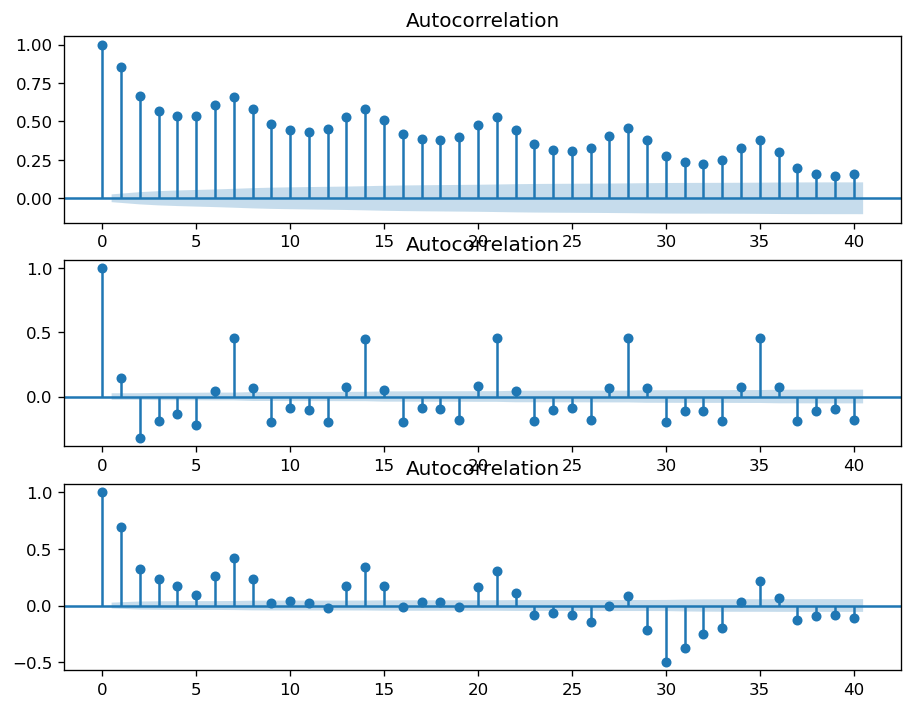

In [114]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff().dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).diff(30).dropna(), ax=ax3,lags=40)

In [115]:
df_daily

,PJMW_MW,PJMW_MW_365 Day Shift,PJMW_MW_30 day Shift,PJMW_MW_120 Day Diffrence,PJMW_MW_7 day shift,PJMW_MW_1 day shift
Datetime,,,,,,
2002-04-01,5271.173913,NaN,NaN,NaN,NaN,NaN
2002-04-02,5310.416667,NaN,NaN,NaN,NaN,39.242754
2002-04-03,5325.916667,NaN,NaN,NaN,NaN,15.500000
2002-04-04,5670.791667,NaN,NaN,NaN,NaN,344.875000
2002-04-05,5686.125000,NaN,NaN,NaN,NaN,15.333333
...,...,...,...,...,...,...
2018-07-30,5492.708333,632.833333,-680.625000,783.000000,-407.333333,198.875000
2018-07-31,5660.750000,-97.000000,-660.750000,76.333333,-481.916667,168.041667
2018-08-01,5959.708333,-55.958333,-856.750000,348.583333,-76.500000,298.958333


### DOUBLE shifting for 7 day shift 

In [116]:
df_daily['1--7 day diff'] = df_daily['PJMW_MW_7 day shift']-df_daily['PJMW_MW_7 day shift'].shift()

<AxesSubplot:xlabel='Datetime'>

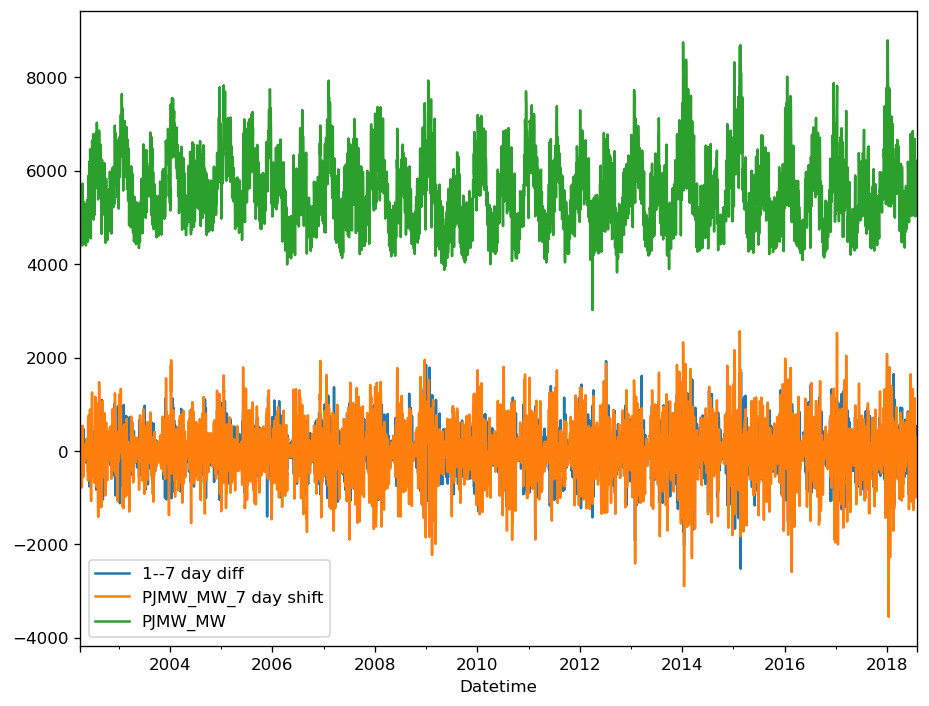

In [117]:
df_daily[['1--7 day diff','PJMW_MW_7 day shift','PJMW_MW']].plot()

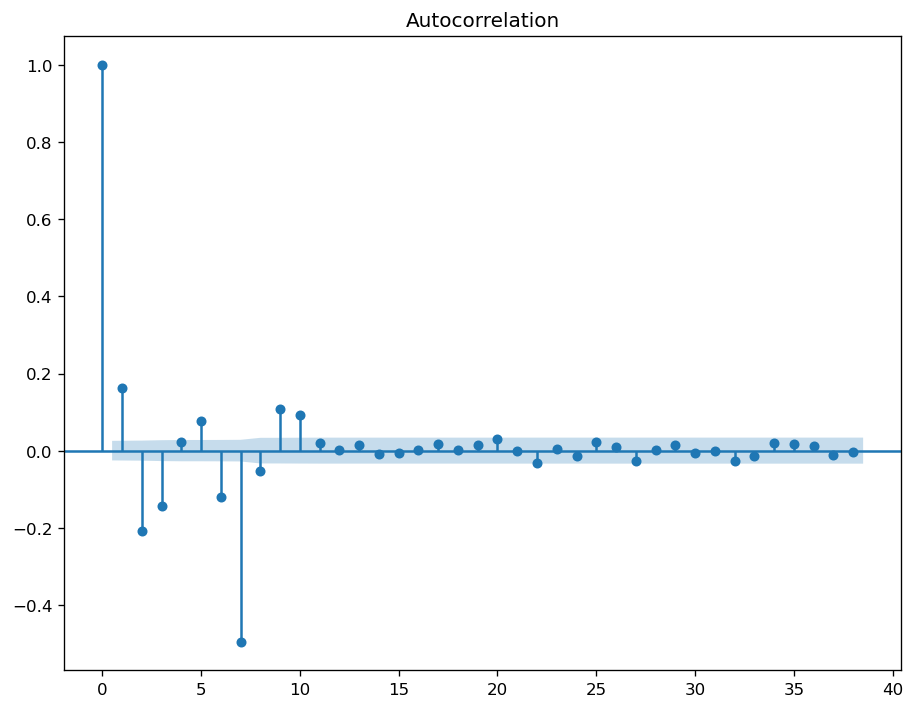

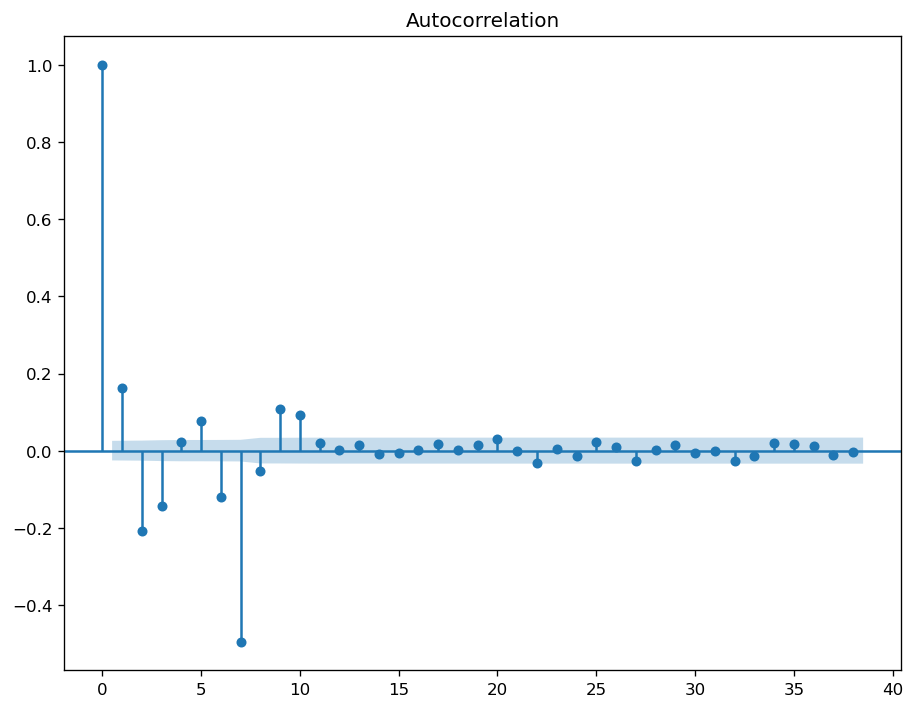

In [118]:
plot_acf(df_daily['1--7 day diff'].dropna())

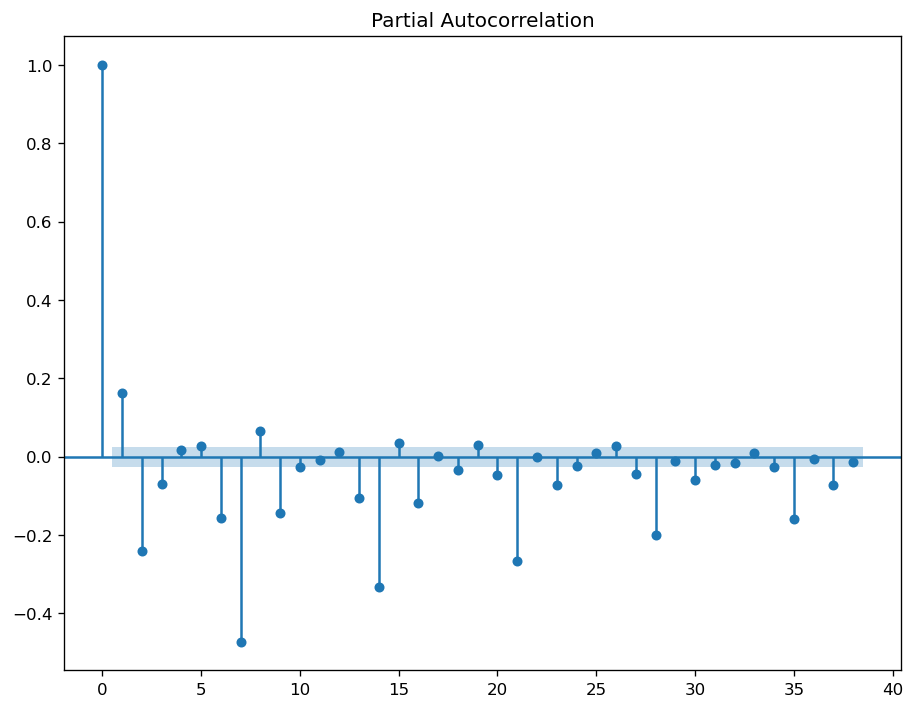

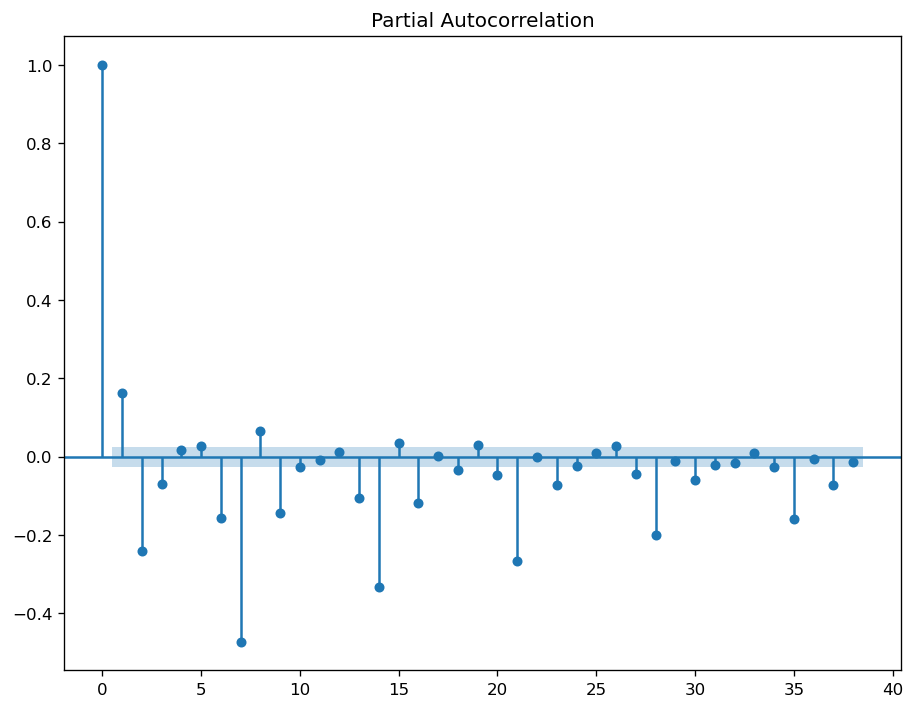

In [119]:
plot_pacf(df_daily['1--7 day diff'].dropna())

In [120]:
adf_test(df_daily['PJMW_MW_1 day shift'].dropna())

ADF Statistics: -14.396915449535339
p-values: 8.636781700463826e-27
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [121]:
adf_test(df_daily['PJMW_MW_7 day shift'].dropna())

ADF Statistics: -13.975138579719898
p-values: 4.275218434205481e-26
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [122]:
adf_test(df_daily['PJMW_MW_30 day Shift'].dropna())

ADF Statistics: -9.193693067246597
p-values: 2.0901318753862318e-15
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [123]:
adf_test(df_daily['PJMW_MW_120 Day Diffrence'].dropna())

ADF Statistics: -7.607002854811055
p-values: 2.30804378284343e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [124]:
adf_test(df_daily['PJMW_MW_365 Day Shift'].dropna())

ADF Statistics: -7.944404396490974
p-values: 3.2489668723080726e-12
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


### Log Transformation

Text(0.5, 1.0, 'Log Transformation')

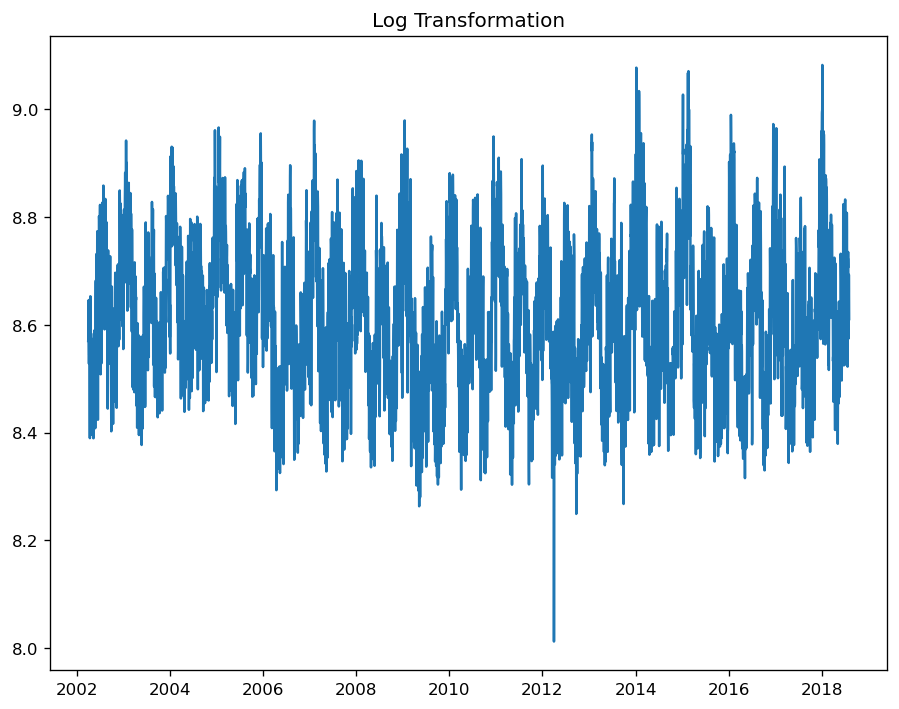

In [125]:
df_log = np.log(df_daily['PJMW_MW'])
plt.plot(df_log)
plt.title('Log Transformation')

In [126]:
adf_test(df_log)

ADF Statistics: -7.355378979339367
p-values: 9.811798786500187e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


### 2. Differencing Simple Moving Average

In [127]:
movingavg = df_log.rolling(window=30,min_periods=1).mean()
df_log_diff_movingavg = df_log-movingavg-movingavg
df_log_diff_movingavg.head()

Datetime
2002-04-01   -8.570008
2002-04-02   -8.570008
2002-04-03   -8.571509
2002-04-04   -8.542345
2002-04-05   -8.560873
Freq: D, Name: PJMW_MW, dtype: float64

### 3.Differencing Exponential Moving Average

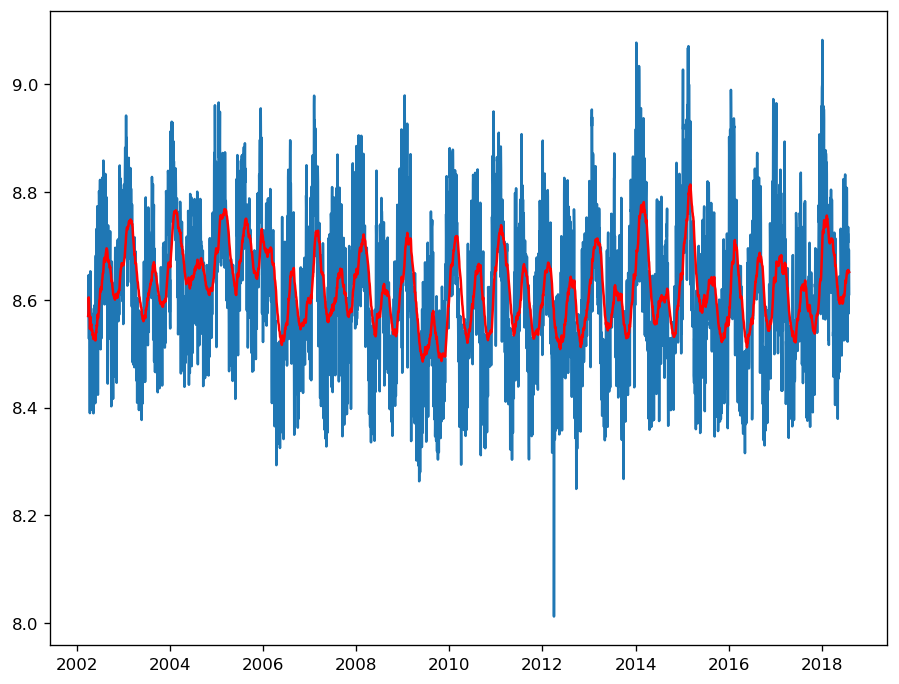

In [128]:
exponentialdecay_movingavg = df_log.ewm(halflife=30,min_periods=0,adjust=True).mean()
plt.plot(df_log.dropna())
plt.plot(exponentialdecay_movingavg.dropna(),color='r')

### 4. Differncing previous log values

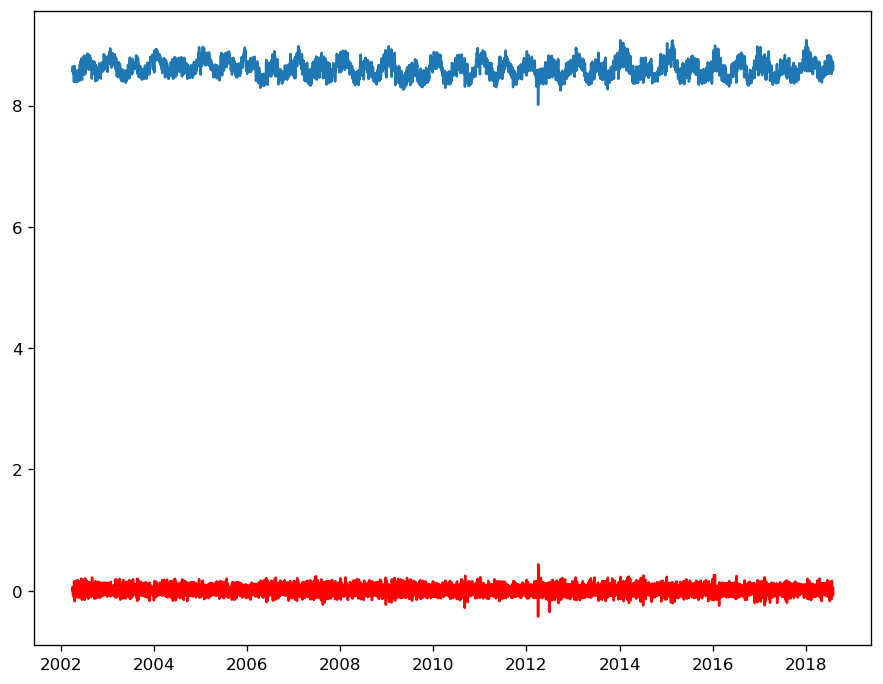

In [129]:
log_2shift = df_log-df_log.shift()
log_2shift.head()
plt.plot(df_log.dropna())
plt.plot(log_2shift.dropna(),color='r')

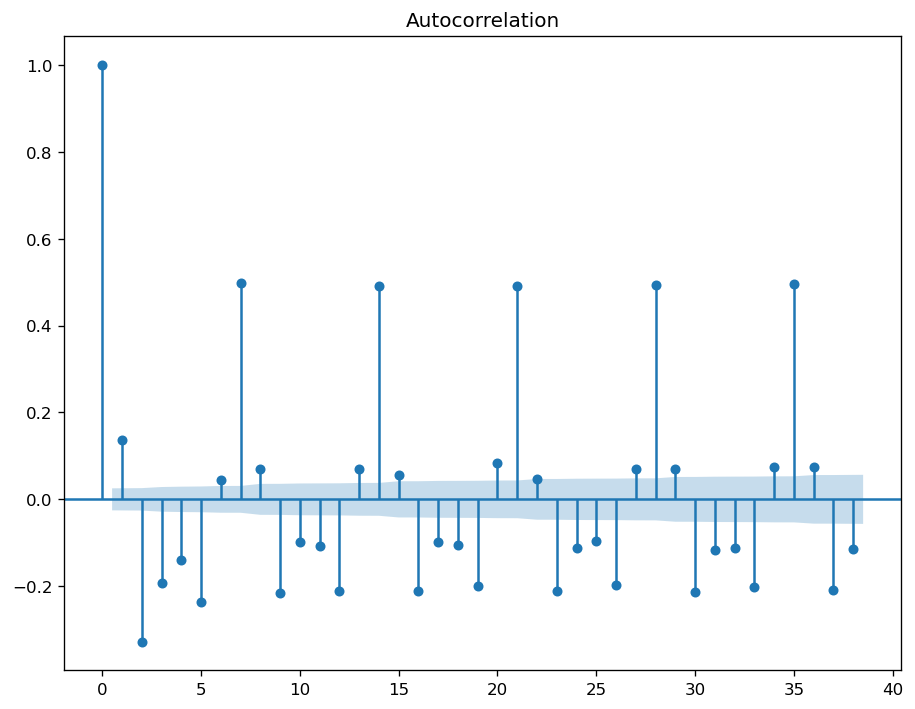

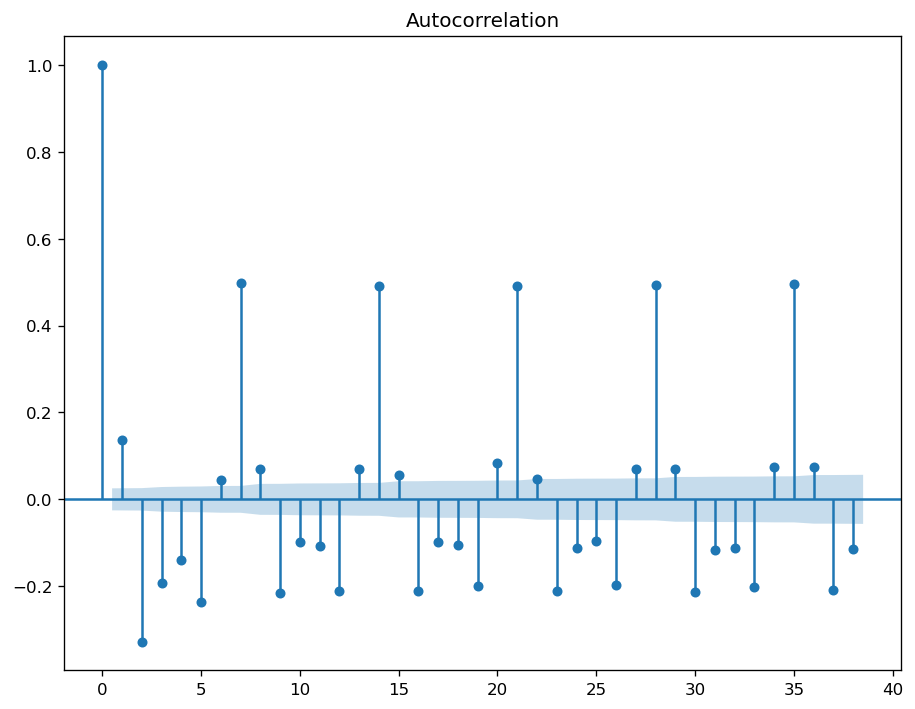

In [130]:
plot_acf(log_2shift.dropna())

###  Finding auto P AND Q values

In [131]:
from statsmodels.tsa.stattools import arma_order_select_ic

In [132]:
arma_order_select_ic(df_daily['PJMW_MW_365 Day Shift'].dropna())

{'bic':               0             1             2
 0  89426.919165  86067.202078  85505.747548
 1  85632.241752  85342.607915  85283.305957
 2  85459.422244  85298.804730  85200.792577
 3  85284.028052  85283.245424  84340.426692
 4  85280.307151  85288.869870  84068.226691,
 'bic_min_order': (4, 2)}

### Model building 

### ARIMA MODEL

#### Forecasting Model::::
ARIMA Model stands for Auto-Regressive Integrated Moving Average. It is is used for predicting future trends on a time series data. It is model that form of regression analysis.

Auto-Regressive models::: predict future behavior using past behavior where there is some correlation between past and future data.(p)

Integration:: is the difference between present and previous observations. It is used to make the time series stationary(d).

Moving Average:: is a statistical method that takes the updated average of values to help cut down on noise. It takes the average over a specific interval of time(q)

In [133]:
from statsmodels.tsa.arima.model import ARIMA

In [134]:
train = df_daily["PJMW_MW"][:5110]
test = df_daily["PJMW_MW"][5110:]
start = len(train)
end = len(train)+len(test)-1

In [135]:
# p,d,q ARIMA Model
model = ARIMA(train, order=(4,1,3))
model_fit = model.fit()
print(model_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 1, 3)   Log Likelihood              -36654.912
Date:                Sun, 09 Oct 2022   AIC                          73325.825
Time:                        15:38:26   BIC                          73378.135
Sample:                    04-01-2002   HQIC                         73344.139
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5217      0.015     34.928      0.000       0.492       0.551
ar.L2         -1.0591      0.011    -94.002      0.000      -1.081      -1.037
ar.L3          0.7453      0.014     52.975      0.0

In [136]:
pred_arima=model_fit.predict(start =start,end=end)

In [137]:
forcast=model_fit.forecast(steps=890)

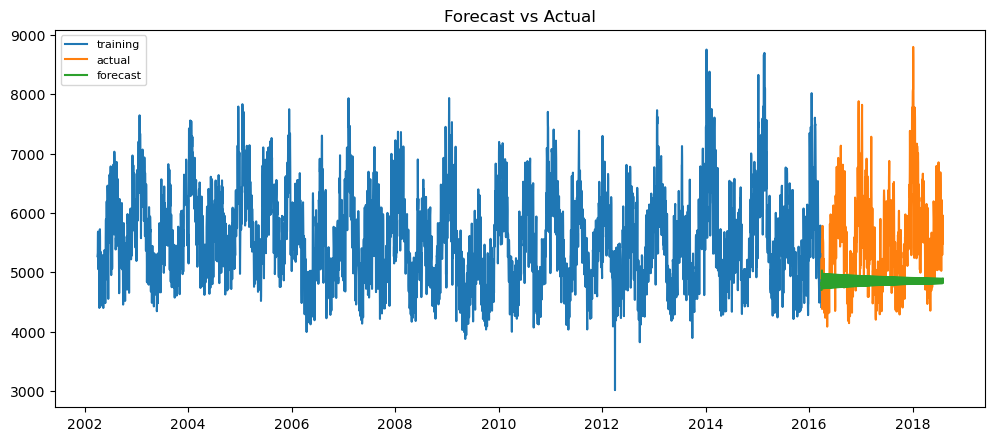

In [138]:
plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)

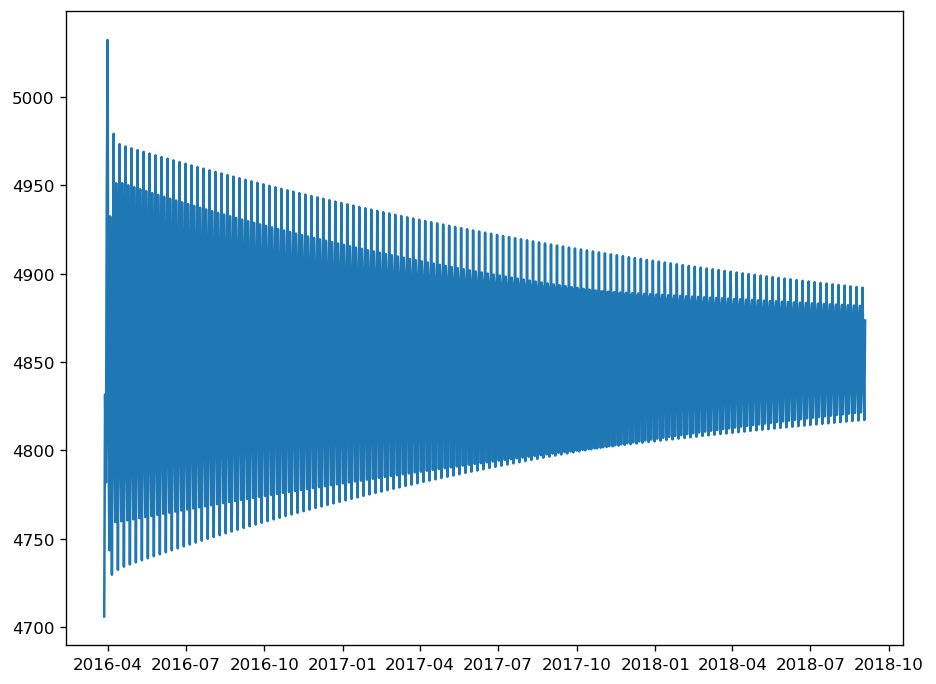

In [139]:
plt.plot(forcast,label='future')
plt.show()

In [141]:
# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error

In [142]:
arima_rmse_error = mean_absolute_error(test, pred_arima)
arima_mse_error = arima_rmse_error**2
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),4)

In [143]:
print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

MSE Error: 624496.8283539505
RMSE Error: 790.2511172747246
MAPE: 13.0642


                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 0, 3)   Log Likelihood              -36937.229
Date:                Sun, 09 Oct 2022   AIC                          73892.459
Time:                        16:06:09   BIC                          73951.309
Sample:                    04-01-2002   HQIC                         73913.062
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8761     51.204    109.520      0.000    5507.518    5708.234
ar.L1          1.4980      0.031     48.185      0.000       1.437       1.559
ar.L2         -0.7485      0.067    -11.132      0.0

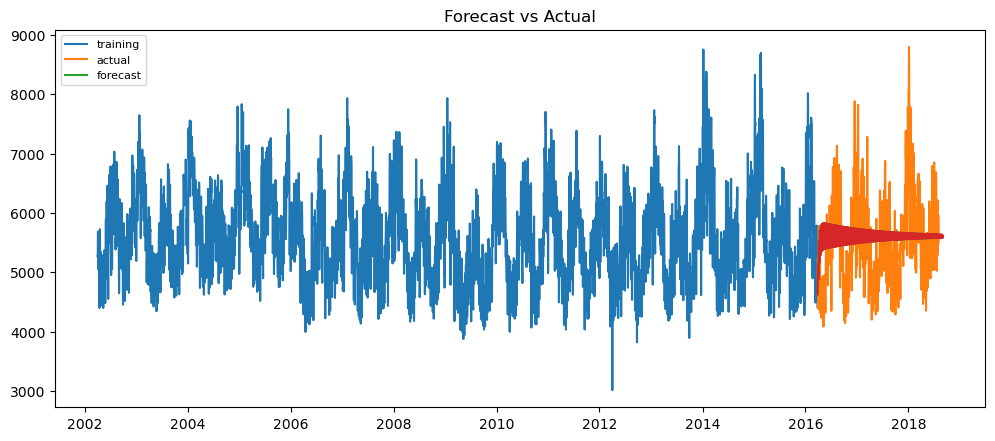

MSE Error: 338314.6361190702
RMSE Error: 581.6482064951891
MAPE: 10.508


In [157]:
# p,d,q ARIMA Model
model = ARIMA(train, order=(4,0,3),trend='c')
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
arima_rmse_error = mean_absolute_error(test, pred_arima)
arima_mse_error = arima_rmse_error**2
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')


                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 0, 4)   Log Likelihood              -36825.607
Date:                Sun, 09 Oct 2022   AIC                          73671.214
Time:                        16:06:25   BIC                          73736.603
Sample:                    04-01-2002   HQIC                         73694.107
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8759   6.82e-08   8.23e+10      0.000    5607.876    5607.876
ar.L1          2.5457      0.033     77.348      0.000       2.481       2.610
ar.L2         -2.9179      0.074    -39.447      0.0

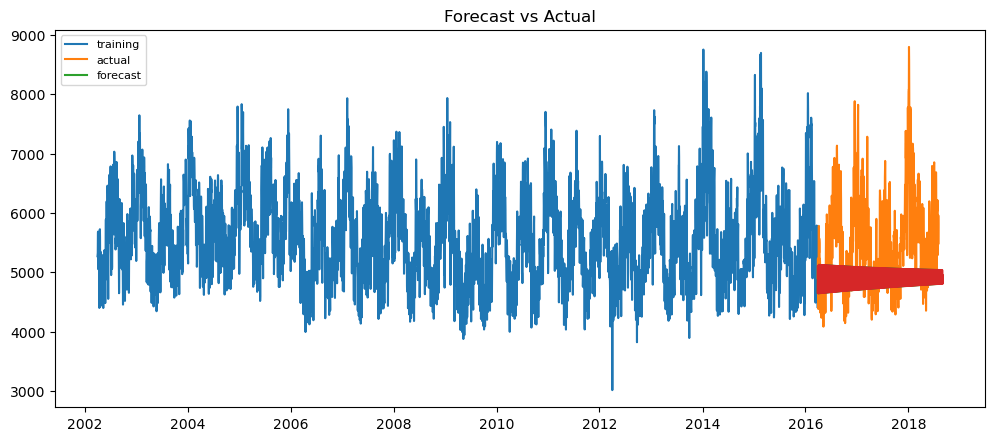

MSE Error: 550634.7891
RMSE Error: 742.0477
MAPE: 12.233


In [158]:
# p=4,d=0,q=4 ARIMA Model
model = ARIMA(train, order=(4,0,4))
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error



arima_rmse_error = round(mean_absolute_error(test, pred_arima),4)
arima_mse_error =(arima_rmse_error**2).round(4)
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(6, 0, 5)   Log Likelihood              -36436.797
Date:                Sun, 09 Oct 2022   AIC                          72899.595
Time:                        16:05:41   BIC                          72984.601
Sample:                    04-01-2002   HQIC                         72929.355
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8762    155.730     36.010      0.000    5302.652    5913.101
ar.L1          0.7951      0.057     13.987      0.000       0.684       0.906
ar.L2         -0.4971      0.099     -5.015      0.0

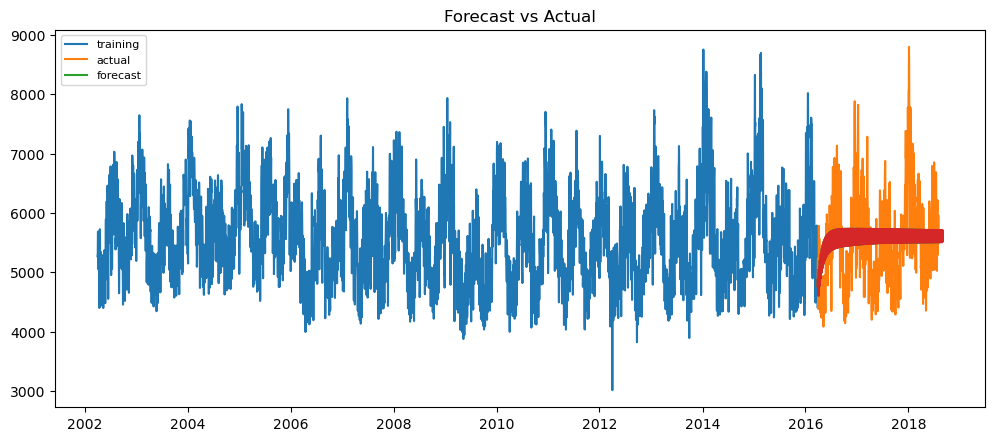

MSE Error: 326009.3674
RMSE Error: 570.9723
MAPE: 10.267


In [156]:
# p=5,d=0,q=4 ARIMA Model
model = ARIMA(train, order=(6,0,5))
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error



arima_rmse_error = round(mean_absolute_error(test, pred_arima),4)
arima_mse_error =(arima_rmse_error**2).round(4)
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

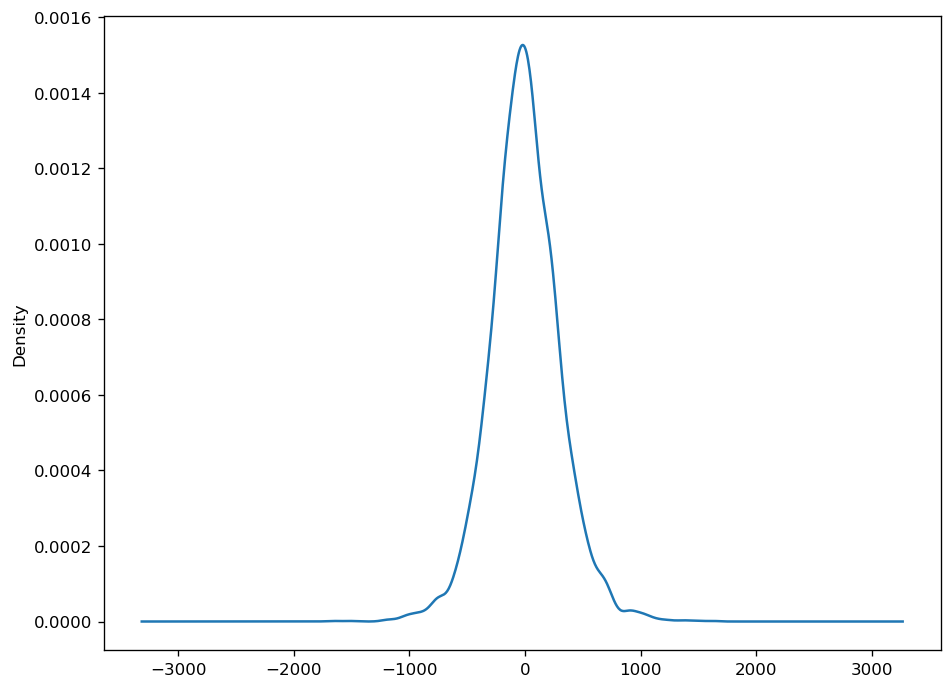

In [155]:
model_fit.resid.plot(kind='kde')
plt.show()

## SARIMA MODEL

### Seasonal Autoregressive Integrated Moving Average, SARIMA or Seasonal ARIMA, is an extension of ARIMA that explicitly supports univariate time series data with a seasonal component.

It adds three new hyperparameters to specify the autoregression (AR), differencing (I), and moving average (MA) for the seasonal component of the series, as well as an additional parameter for the period of the seasonality.

In [159]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [171]:
model_serimax = SARIMAX(train, order=(6,0,5), seasonal_order=(1,0,1,12))

In [172]:
sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(6, 0, 5)x(1, 0, [1], 12)   Log Likelihood              -36535.249
Date:                              Sun, 09 Oct 2022   AIC                          73098.498
Time:                                      16:24:20   BIC                          73190.043
Sample:                                  04-01-2002   HQIC                         73130.548
                                       - 03-27-2016                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8069      0.004    185.823      0.000       0.798       0.815
ar.L2         -0.45

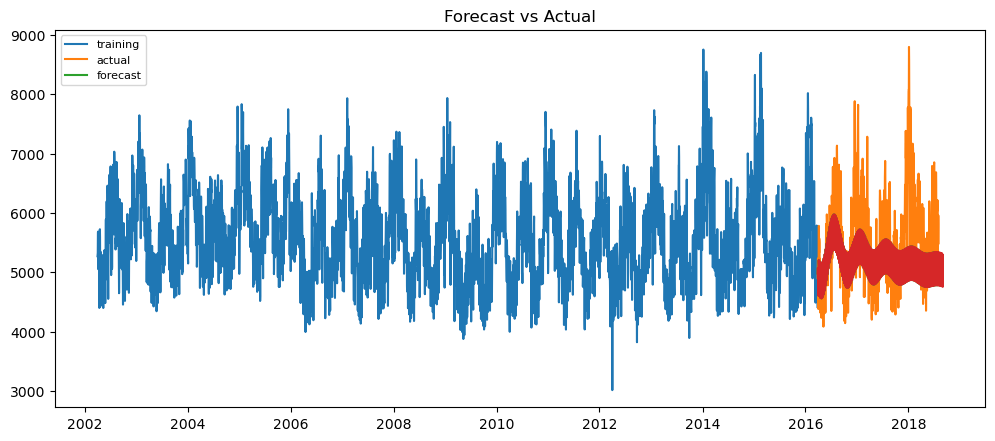

MSE Error: 295977.1278
RMSE Error: 544.0378
MAPE: 9.194


In [176]:
pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 0, 4)x(1, 0, [1], 7)   Log Likelihood              -35949.832
Date:                             Tue, 11 Oct 2022   AIC                          71919.663
Time:                                     13:58:26   BIC                          71985.053
Sample:                                 04-01-2002   HQIC                         71942.556
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.8299      0.011    259.090      0.000       2.808       2.851
ar.L2         -2.6680      

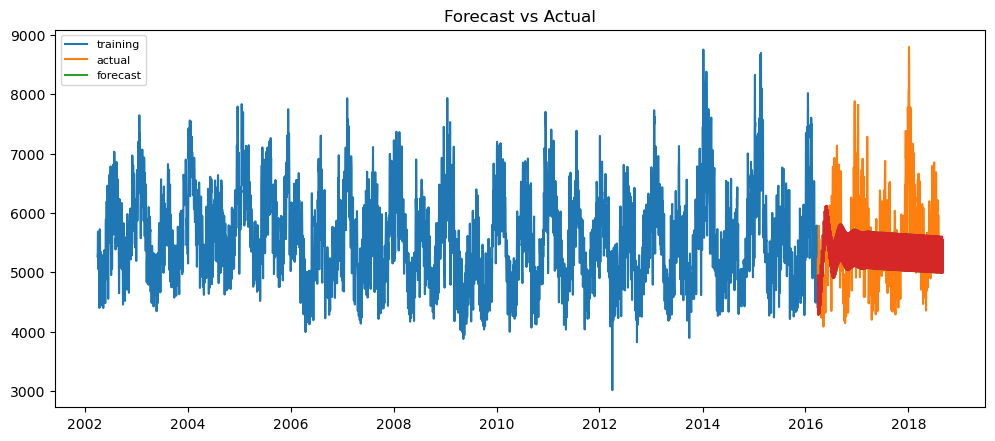

MSE Error: 334991.3817
RMSE Error: 578.7844
MAPE: 10.129


In [177]:
model_serimax = SARIMAX(train, order=(3,0,4), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(4, 0, 3)x(1, 0, [1], 7)   Log Likelihood              -35885.165
Date:                             Tue, 11 Oct 2022   AIC                          71790.330
Time:                                     13:58:40   BIC                          71855.719
Sample:                                 04-01-2002   HQIC                         71813.222
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.6408      0.032     82.758      0.000       2.578       2.703
ar.L2         -2.3070      

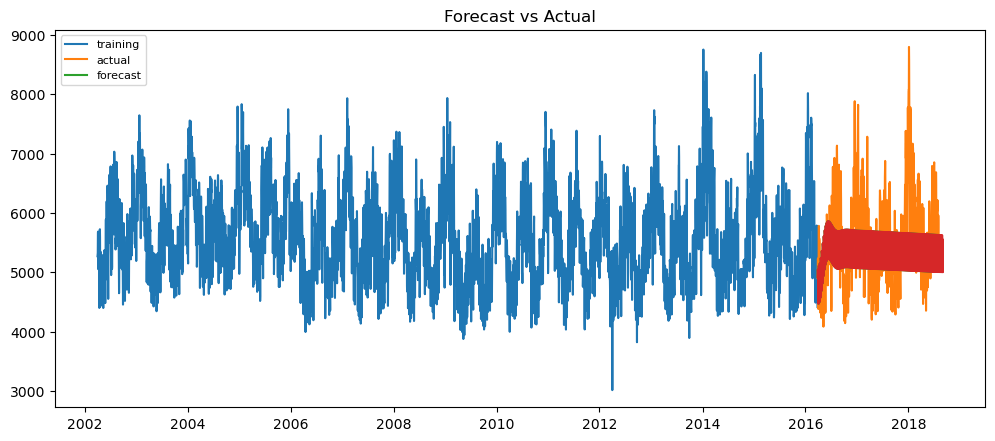

MSE Error: 315888.0623
RMSE Error: 562.0392
MAPE: 9.834


In [178]:
model_serimax = SARIMAX(train, order=(4,0,3), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(4, 0, 4)x(1, 0, [1], 7)   Log Likelihood              -36067.810
Date:                             Tue, 11 Oct 2022   AIC                          72157.619
Time:                                     13:59:02   BIC                          72229.548
Sample:                                 04-01-2002   HQIC                         72182.801
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.7569      0.018     98.212      0.000       1.722       1.792
ar.L2          0.2397      

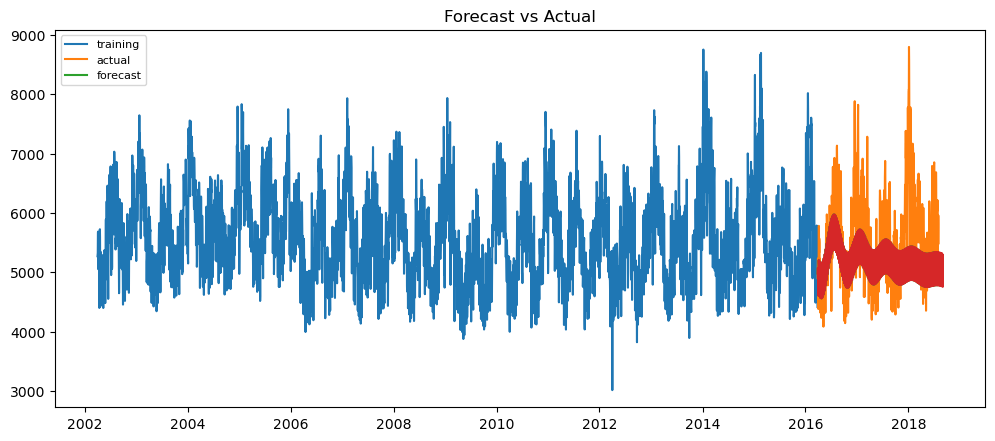

MSE Error: 295977.1278
RMSE Error: 544.0378
MAPE: 9.194


In [179]:
model_serimax = SARIMAX(train, order=(4,0,4), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                     SARIMAX Results                                      
Dep. Variable:                            PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 7)   Log Likelihood              -36475.975
Date:                            Tue, 11 Oct 2022   AIC                          72967.951
Time:                                    13:59:40   BIC                          73020.250
Sample:                                04-01-2002   HQIC                         72986.262
                                     - 03-27-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7279      0.010    -72.304      0.000      -0.748      -0.708
ar.L2          0.4155      0.013   

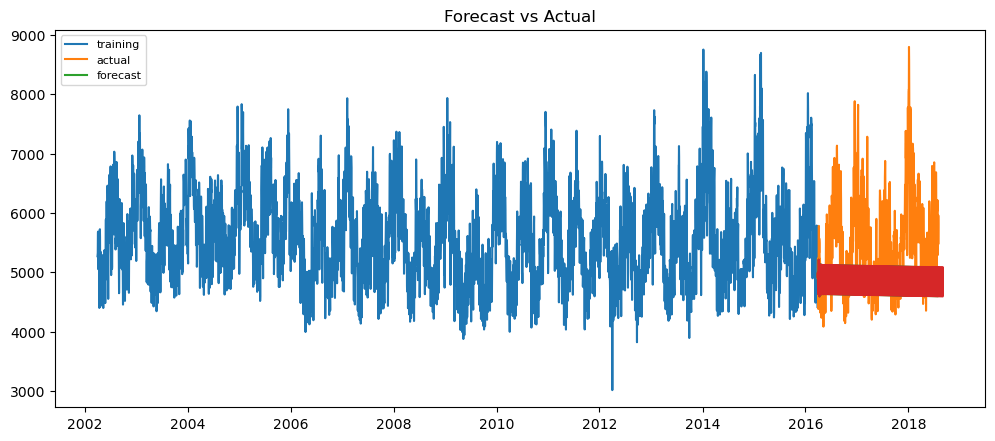

MSE Error: 682006.7506
RMSE Error: 825.837
MAPE: 13.678


In [180]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 7)   Log Likelihood              -35843.578
Date:                             Tue, 11 Oct 2022   AIC                          71705.156
Time:                                     14:05:03   BIC                          71763.992
Sample:                                 04-01-2002   HQIC                         71725.756
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3295      0.271     -1.214      0.225      -0.862       0.203
ar.L2          0.5664      

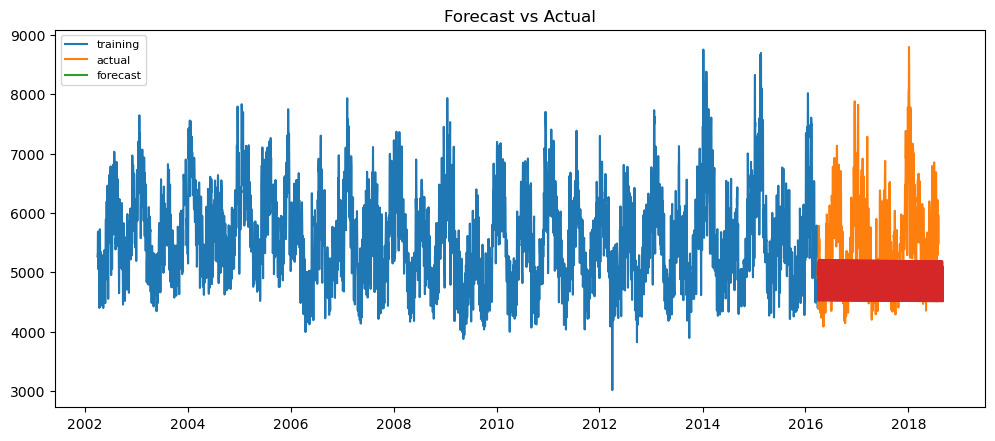

MSE Error: 484484.0712
RMSE Error: 696.0489
MAPE: 11.53


In [181]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 30)   Log Likelihood              -37011.444
Date:                              Tue, 11 Oct 2022   AIC                          74040.888
Time:                                      14:10:55   BIC                          74099.684
Sample:                                  04-01-2002   HQIC                         74061.478
                                       - 03-27-2016                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.2356      0.028     78.493      0.000       2.180       2.291
ar.L2         -2.21

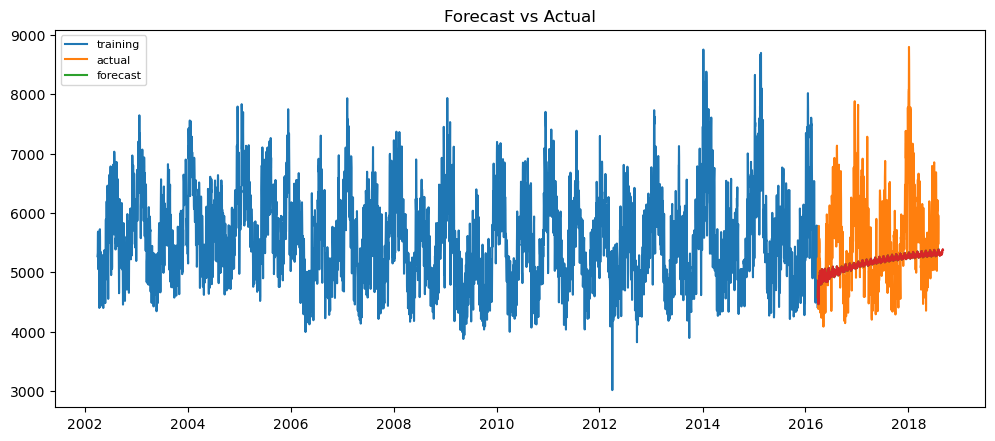

MSE Error: 393198.4747
RMSE Error: 627.0554
MAPE: 10.547


In [182]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,30))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 30)   Log Likelihood              -38059.780
Date:                             Tue, 11 Oct 2022   AIC                          76135.559
Time:                                     14:19:36   BIC                          76187.822
Sample:                                 04-01-2002   HQIC                         76153.862
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2709      0.009     31.358      0.000       0.254       0.288
ar.L2          0.2192      

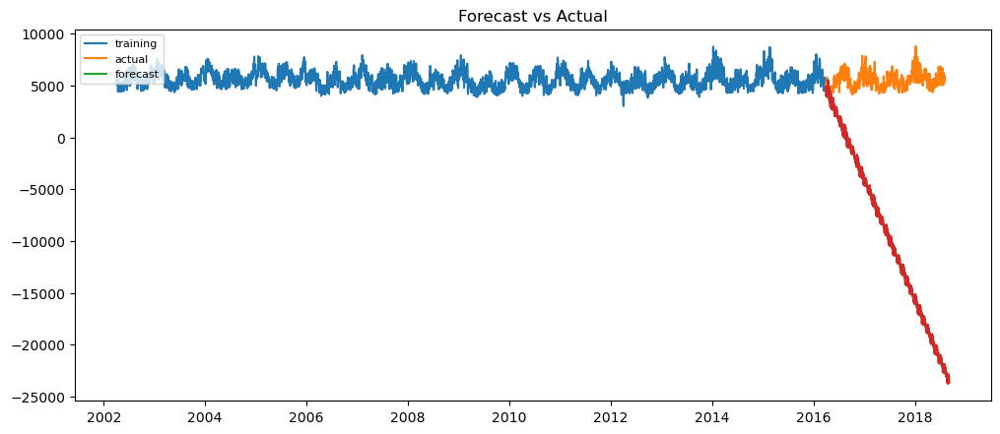

MSE Error: 208658634.5794
RMSE Error: 14445.0211
MAPE: 258.695


In [183]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,30))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 90)   Log Likelihood              -36691.969
Date:                              Tue, 11 Oct 2022   AIC                          73401.939
Time:                                      17:24:37   BIC                          73460.628
Sample:                                  04-01-2002   HQIC                         73422.505
                                       - 03-27-2016                                         
Covariance Type:                       Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0222        nan        nan        nan         nan         nan
ar.L2          0.24

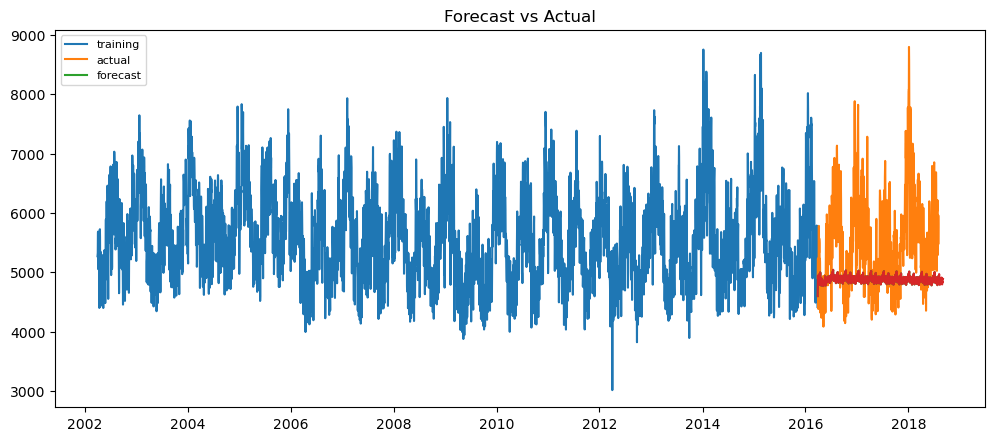

MSE Error: 587324.8162
RMSE Error: 766.3712
MAPE: 12.69


In [186]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,90))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                       SARIMAX Results                                       
Dep. Variable:                               PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 120)   Log Likelihood              -36568.267
Date:                               Tue, 11 Oct 2022   AIC                          73154.534
Time:                                       19:27:16   BIC                          73213.169
Sample:                                   04-01-2002   HQIC                         73175.087
                                        - 03-27-2016                                         
Covariance Type:                        Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3674        nan        nan        nan         nan         nan
ar.L2      

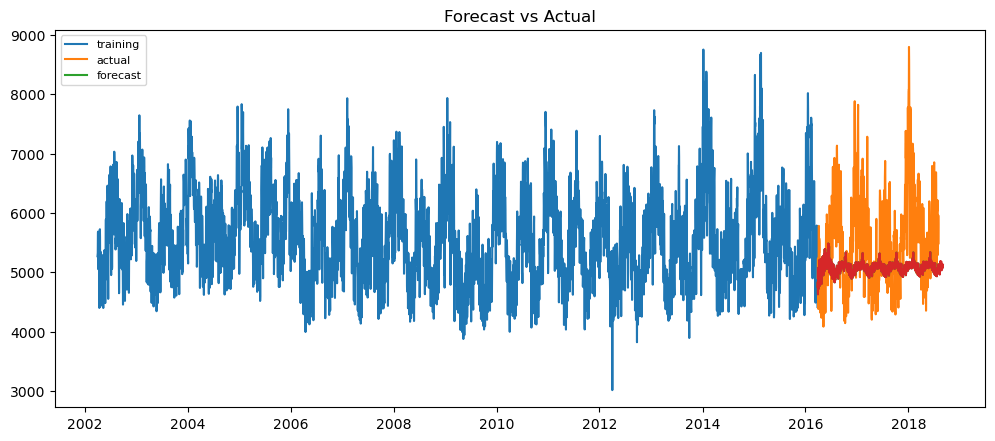

MSE Error: 470632.3587
RMSE Error: 686.0265
MAPE: 11.491


In [187]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,120))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 120)   Log Likelihood              -37348.460
Date:                              Wed, 12 Oct 2022   AIC                          74712.919
Time:                                      00:25:17   BIC                          74765.039
Sample:                                  04-01-2002   HQIC                         74731.188
                                       - 03-27-2016                                         
Covariance Type:                       Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3189        nan        nan        nan         nan         nan
ar.L2         -0.65

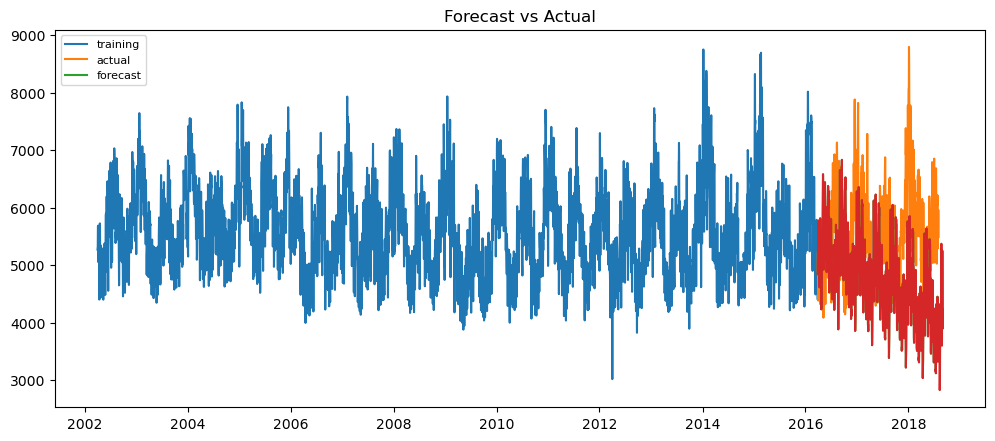

MSE Error: 1231260.9829
RMSE Error: 1109.622
MAPE: 19.111


In [188]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,120))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')